In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d
import seaborn as sns
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import  f1_score, accuracy_score, roc_auc_score
from sklearn.model_selection import KFold
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import KFold
from collections import Counter

# Import and Detection of features

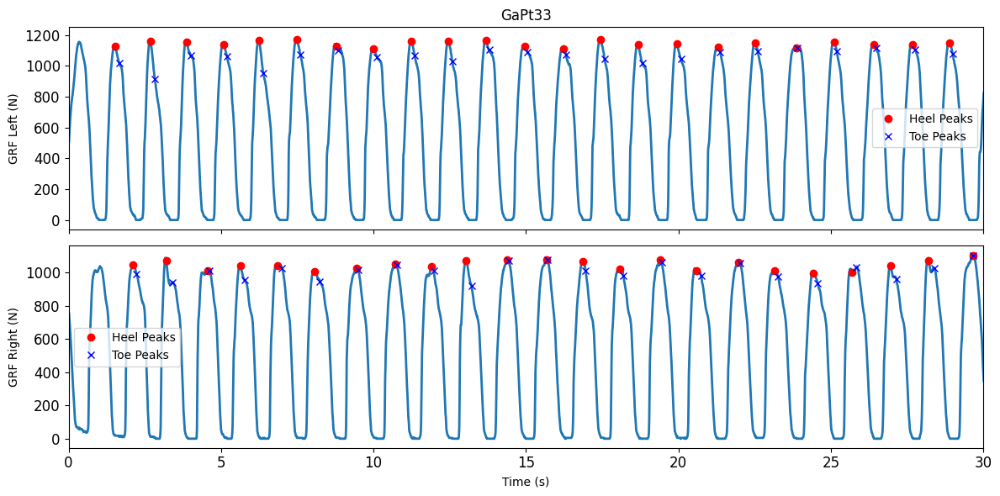

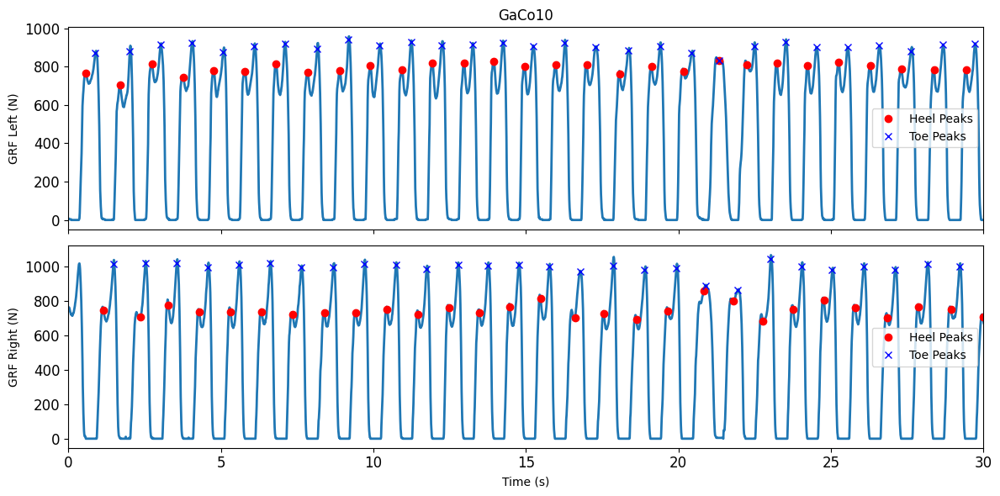

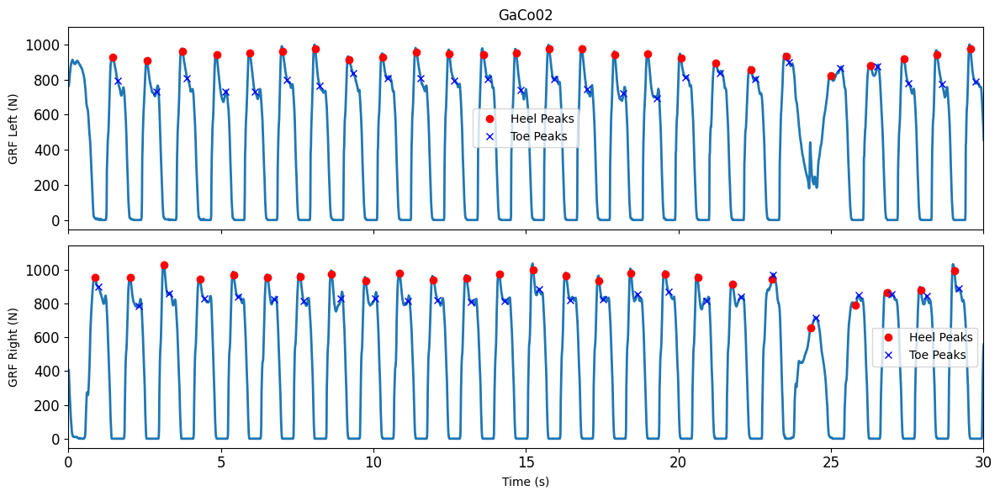

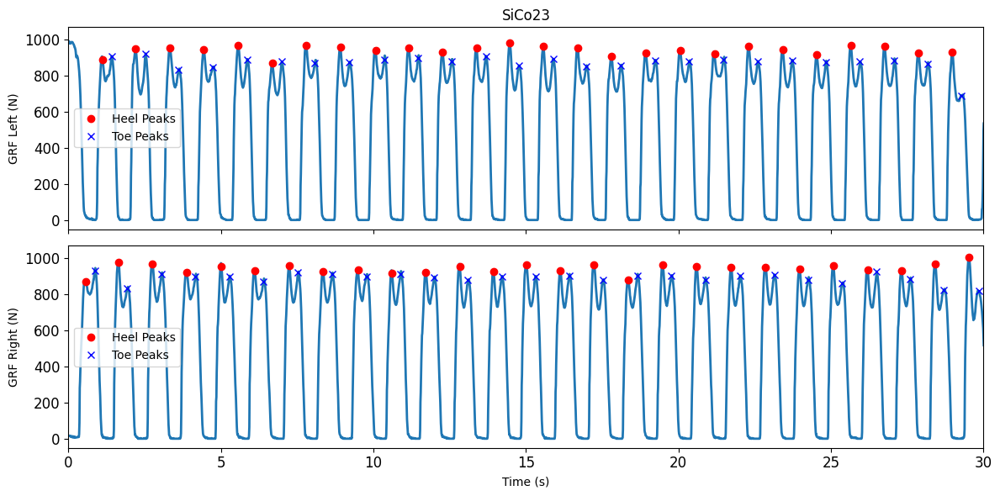

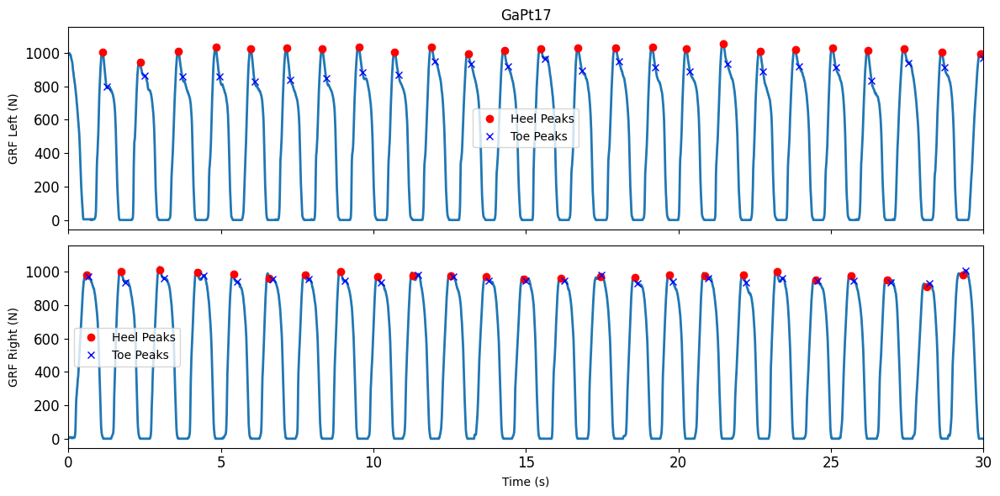

...

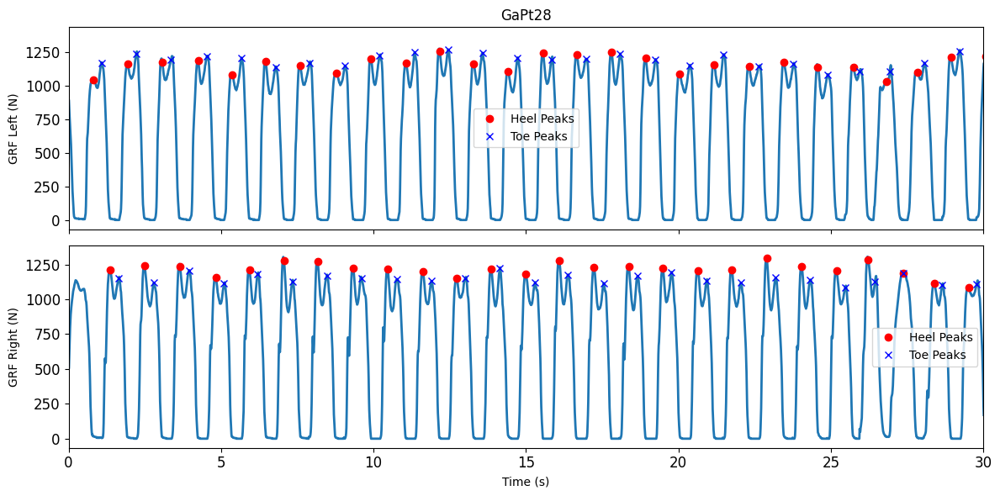

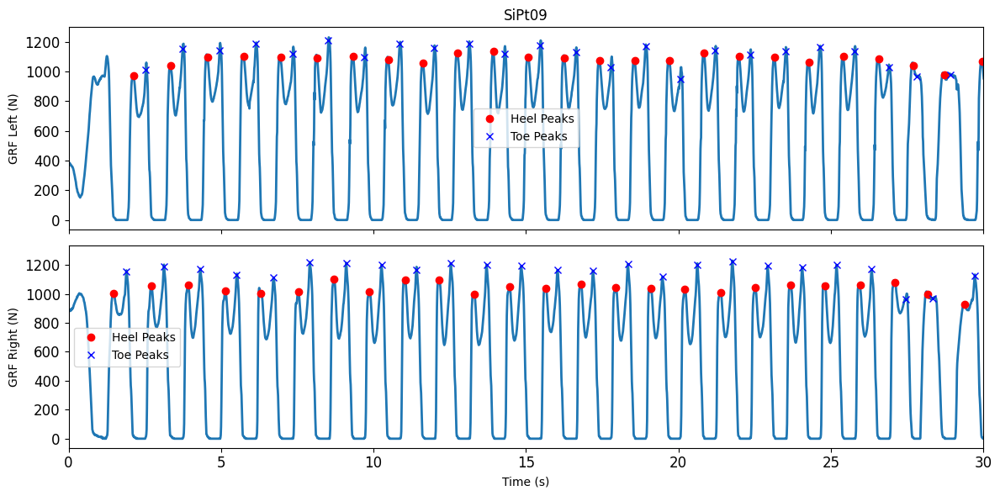

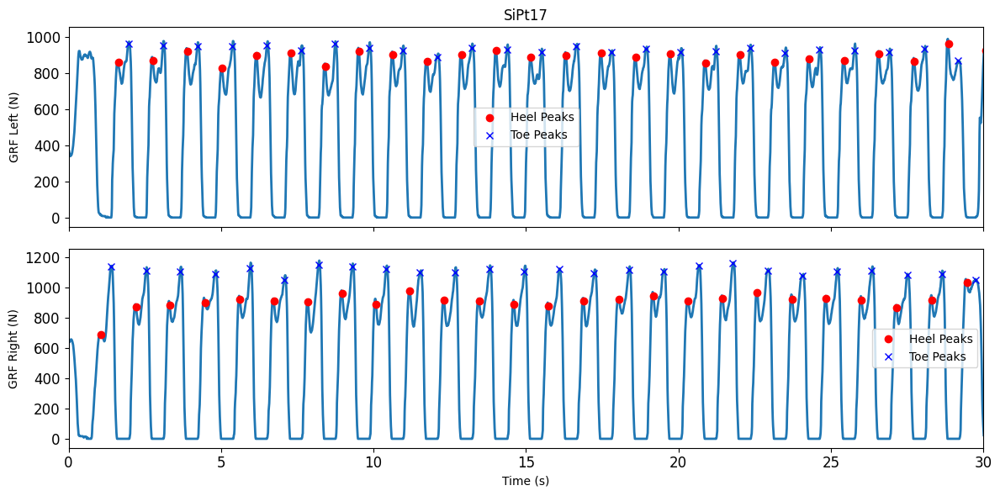

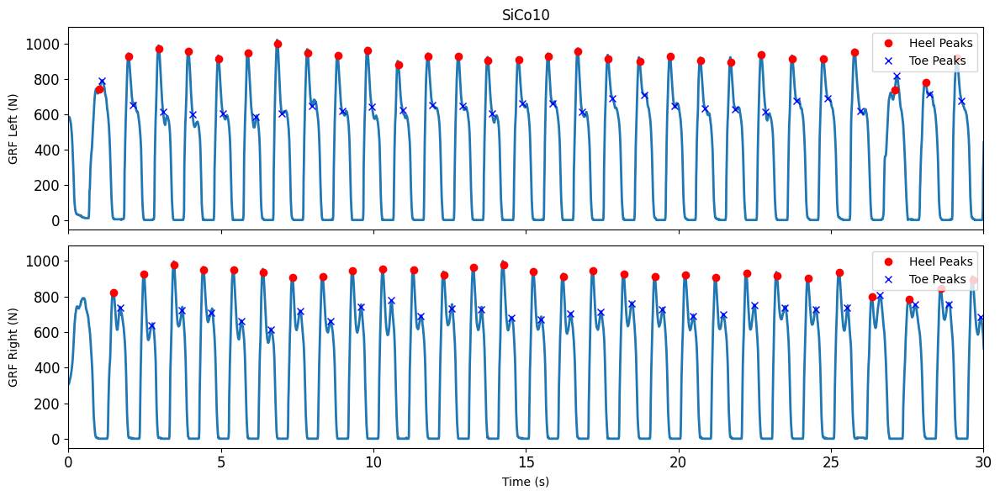

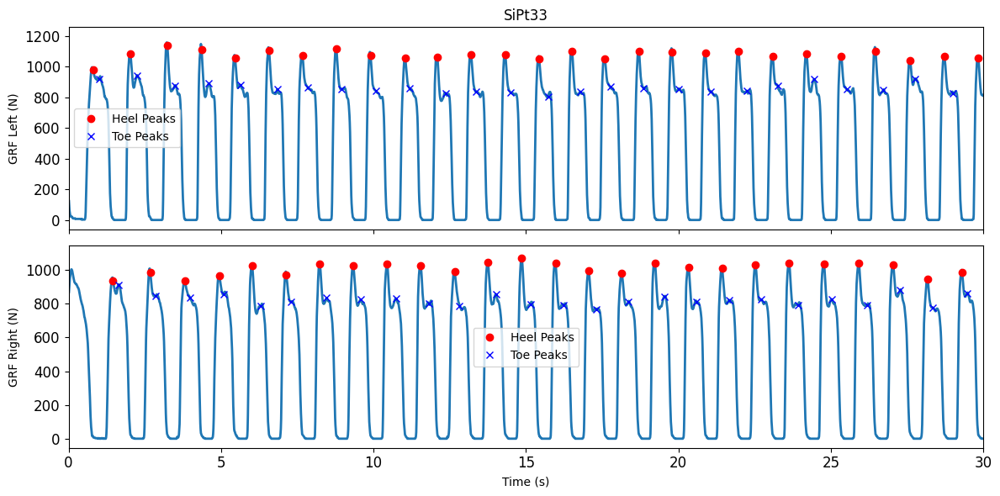

In [2]:
# Parameters
filepath = r"/Users/maxime/Desktop/ucd/semestre1/machine_learning/projet"  
plotOn = True
saveOn = False
fs = 100  

filenames_list =[]


filelist = [f for f in os.listdir(filepath) if f.endswith("_01.txt")]


X = np.full((len(filelist), 16), np.nan)
Y = np.zeros(len(filelist))  

def detect_peaks(signal, heel_idx, toe_idx):
    heel_peaks = []
    toe_peaks = []
    for hs, to in zip(heel_idx, toe_idx):
        if to <= hs:
            continue
        segment = signal[hs:to]
        if len(segment) == 0:
            continue
        peaks, _ = find_peaks(segment, distance=max(1, int(0.02 * len(segment))))
        if len(peaks) >= 2:
            heel_peaks.append(hs + peaks[0])
            toe_peaks.append(hs + peaks[-1])
        else:
            mid = len(segment)//2
            heel_peaks.append(hs + np.argmax(segment[:mid]))
            toe_peaks.append(hs + mid + np.argmax(segment[mid:]))
    return np.array(heel_peaks), np.array(toe_peaks)


# Contact detection function 
def detect_contact(signal, max_stride_duration=1.6, fs=100):
    threshold = 0.014 * np.max(signal)
    contact = signal > threshold
    contact_diff = np.diff(contact.astype(int))
    heel_idx = np.where(contact_diff == 1)[0]
    toe_idx = np.where(contact_diff == -1)[0]

    # Ensure that the first toe-off is not before the first heel
    if len(toe_idx) > 0 and len(heel_idx) > 0 and toe_idx[0] < heel_idx[0]:
        toe_idx = toe_idx[1:]

    # Detect special stride
    corrected_heel = []
    corrected_toe = []
    max_stride_samples = int(max_stride_duration * fs)

    for hs, to in zip(heel_idx, toe_idx):
        if to <= hs:
            continue

        duration = to - hs
        if duration > max_stride_samples:
            segment = signal[hs:to]
            if len(segment) == 0:
                continue

            local_thresh = threshold
            max_iter = 5
            all_contacts_found = []

            for _ in range(max_iter):
                contact_local = segment > local_thresh
                contact_diff_local = np.diff(contact_local.astype(int))

                local_heel = np.where(contact_diff_local == 1)[0]
                local_toe = np.where(contact_diff_local == -1)[0]

                # Verify that each toe has a heel corresponding
                if len(local_toe) > 0 and len(local_heel) > 0 and local_toe[0] < local_heel[0]:
                    local_toe = local_toe[1:]

                pairs = []
                for lh, lt in zip(local_heel, local_toe):
                    if lt > lh:
                        pairs.append((hs + lh, hs + lt))

                
                if len(pairs) > 0:
                    all_contacts_found = pairs
                    break
                else:
                    # Increase the treshold to detect something
                    local_thresh *= 50

            if len(all_contacts_found) > 0:
                for heel, toe in all_contacts_found:
                    corrected_heel.append(heel)
                    corrected_toe.append(toe)
            else:
                corrected_heel.append(hs)
                corrected_toe.append(to)
        else:
            corrected_heel.append(hs)
            corrected_toe.append(to)

    return np.array(corrected_heel), np.array(corrected_toe)


#Main loop
patient_data = []
for i, filename in enumerate(filelist):
    label = filename[2:4]
    filenames_list.append(filename)  
    if label == "Pt":
        Y[i] = 1

    sensordata = np.loadtxt(os.path.join(filepath, filename))
    time = sensordata[:, 0]
    totalForceLeft = sensordata[:, 17]
    totalForceRight = sensordata[:, 18]

    signal_smooth_R = gaussian_filter1d(totalForceRight, sigma=5)
    signal_smooth_L = gaussian_filter1d(totalForceLeft, sigma=5)

    heel_strike_idx_R, toe_off_idx_R = detect_contact(signal_smooth_R, fs=fs)
    heel_strike_idx_L, toe_off_idx_L = detect_contact(signal_smooth_L, fs=fs)

    
    heel_peaks_R, toe_peaks_R = detect_peaks(signal_smooth_R, heel_strike_idx_R, toe_off_idx_R)
    heel_peaks_L, toe_peaks_L = detect_peaks(signal_smooth_L, heel_strike_idx_L, toe_off_idx_L)



    patient_data.append({
        "filename": filename,
        "signal_smooth_L": signal_smooth_L,
        "signal_smooth_R": signal_smooth_R,
        "heel_peaks_L": heel_peaks_L,
        "toe_peaks_L": toe_peaks_L,
        "heel_peaks_R": heel_peaks_R,
        "toe_peaks_R": toe_peaks_R,
        "time": time
    })


        #  Features  

    #  STRIDE 
    stride_mean_L = np.nan
    stride_mean_R = np.nan
    stride_intervals_L, stride_intervals_R = [], []

    if len(heel_peaks_L) > 1:
        stride_intervals_L = np.diff(heel_peaks_L) / fs
        stride_mean_L = np.mean(stride_intervals_L)

    if len(heel_peaks_R) > 1:
        stride_intervals_R = np.diff(heel_peaks_R) / fs
        stride_mean_R = np.mean(stride_intervals_R)

    if len(stride_intervals_L) > 0 and len(stride_intervals_R) > 0:
        stride_all = np.concatenate([stride_intervals_L, stride_intervals_R])
        stride_mean_global = np.mean(stride_all)
        stride_cv_global = np.std(stride_all) / stride_mean_global if stride_mean_global > 0 else np.nan
        stride_sym = (stride_mean_R - stride_mean_L) / ((stride_mean_R + stride_mean_L) / 2) \
                    if (stride_mean_R + stride_mean_L) != 0 else np.nan
    else:
        stride_mean_global, stride_cv_global, stride_sym = np.nan, np.nan, np.nan

    #  PEAK FORCE 
    if len(heel_peaks_L) > 0 and len(toe_peaks_L) > 0 and len(heel_peaks_R) > 0 and len(toe_peaks_R) > 0:
        min_len_L = min(len(heel_peaks_L), len(toe_peaks_L))
        min_len_R = min(len(heel_peaks_R), len(toe_peaks_R))
        force_diff_L = (signal_smooth_L[heel_peaks_L[:min_len_L]] - signal_smooth_L[toe_peaks_L[:min_len_L]])
        force_diff_R = (signal_smooth_R[heel_peaks_R[:min_len_R]] - signal_smooth_R[toe_peaks_R[:min_len_R]])
        all_force_diff = np.concatenate([force_diff_L, force_diff_R])

        force_diff_mean_global = np.mean(all_force_diff)
        force_diff_cv_global = np.std(all_force_diff) / force_diff_mean_global
        mean_L, mean_R = np.mean(force_diff_L), np.mean(force_diff_R)
        force_diff_sym = (mean_R - mean_L) / ((mean_R + mean_L)/2) if (mean_R + mean_L) != 0 else np.nan
    else:
        force_diff_mean_global, force_diff_cv_global, force_diff_sym = np.nan, np.nan, np.nan

    #  DOUBLE SUPPORT 
    double_support_durations = []
    if len(heel_strike_idx_L) > 0 and len(toe_off_idx_L) > 0 and len(heel_strike_idx_R) > 0 and len(toe_off_idx_R) > 0:
        for hs_L, to_L in zip(heel_strike_idx_L, toe_off_idx_L):
            overlap = np.sum((heel_strike_idx_R < to_L) & (toe_off_idx_R > hs_L))
            if overlap > 0:
                duration = min(to_L, max(toe_off_idx_R)) - max(hs_L, min(heel_strike_idx_R))
                if duration > 0:
                    double_support_durations.append(duration / fs)

    if len(double_support_durations) > 0:
        double_support_mean = np.mean(double_support_durations)
        double_support_cv = np.std(double_support_durations) / double_support_mean if double_support_mean > 0 else np.nan
    else:
        double_support_mean, double_support_cv = np.nan, np.nan

    # SWING CV 
    swing_times = []
    if len(toe_off_idx_L) > 0 and len(heel_strike_idx_L) > 1:
        swing_L = (heel_strike_idx_L[1:] - toe_off_idx_L[:-1]) / fs
        swing_times.extend(swing_L[swing_L > 0])
    if len(toe_off_idx_R) > 0 and len(heel_strike_idx_R) > 1:
        swing_R = (heel_strike_idx_R[1:] - toe_off_idx_R[:-1]) / fs
        swing_times.extend(swing_R[swing_R > 0])

    if len(swing_times) > 0:
        swing_cv = np.std(swing_times) / np.mean(swing_times)
    else:
        swing_cv = np.nan

    #  STANCE CV 
    stance_times = []
    if len(heel_strike_idx_L) > 0 and len(toe_off_idx_L) > 0:
        stance_L = (toe_off_idx_L - heel_strike_idx_L) / fs
        stance_times.extend(stance_L)
    if len(heel_strike_idx_R) > 0 and len(toe_off_idx_R) > 0:
        stance_R = (toe_off_idx_R - heel_strike_idx_R) / fs
        stance_times.extend(stance_R)

    if len(stance_times) > 0:
        stance_cv = np.std(stance_times) / np.mean(stance_times)
    else:
        stance_cv = np.nan


    eps = 1e-6

    # Means
    stance_mean_L = np.nan
    stance_mean_R = np.nan
    swing_mean_L = np.nan
    swing_mean_R = np.nan

    if len(heel_strike_idx_L) > 0 and len(toe_off_idx_L) > 0:
        # stance_L :
        stance_L = (toe_off_idx_L - heel_strike_idx_L) / fs
        stance_mean_L = np.mean(stance_L) if len(stance_L)>0 else np.nan

    if len(heel_strike_idx_R) > 0 and len(toe_off_idx_R) > 0:
        stance_R = (toe_off_idx_R - heel_strike_idx_R) / fs
        stance_mean_R = np.mean(stance_R) if len(stance_R)>0 else np.nan

    if len(toe_off_idx_L) > 0 and len(heel_strike_idx_L) > 1:
        swing_L = (heel_strike_idx_L[1:] - toe_off_idx_L[:-1]) / fs
        swing_mean_L = np.mean(swing_L[swing_L>0]) if np.any(swing_L>0) else np.nan

    if len(toe_off_idx_R) > 0 and len(heel_strike_idx_R) > 1:
        swing_R = (heel_strike_idx_R[1:] - toe_off_idx_R[:-1]) / fs
        swing_mean_R = np.mean(swing_R[swing_R>0]) if np.any(swing_R>0) else np.nan

    #  stance / swing ratio 
    ratio_L = np.nan
    ratio_R = np.nan
    if not np.isnan(stance_mean_L) and not np.isnan(swing_mean_L) and swing_mean_L > eps:
        ratio_L = stance_mean_L / max(swing_mean_L, eps)
    if not np.isnan(stance_mean_R) and not np.isnan(swing_mean_R) and swing_mean_R > eps:
        ratio_R = stance_mean_R / max(swing_mean_R, eps)

    ratio_vals = np.array([v for v in [ratio_L, ratio_R] if not np.isnan(v)])
    if ratio_vals.size > 0:
        stance_swing_mean_global = np.mean(ratio_vals)
        stance_swing_cv_global = np.std(ratio_vals) / (stance_swing_mean_global if stance_swing_mean_global>eps else np.nan)
    else:
        stance_swing_mean_global = np.nan
        stance_swing_cv_global = np.nan

    # symetrie stance/swing (R vs L)
    if not np.isnan(ratio_R) and not np.isnan(ratio_L) and (ratio_R + ratio_L) != 0:
        stance_swing_sym = (ratio_R - ratio_L) / ((ratio_R + ratio_L) / 2)
    else:
        stance_swing_sym = np.nan

    # --- double support / step ---
    if not np.isnan(double_support_mean) and not np.isnan(stride_mean_global) and stride_mean_global > eps:
        step_est = stride_mean_global / 2.0
        ds_over_step_mean = double_support_mean / max(step_est, eps)
        if len(double_support_durations) > 0:
            ds_over_step_vals = np.array(double_support_durations) / max(step_est, eps)
            ds_over_step_cv = np.std(ds_over_step_vals) / (np.mean(ds_over_step_vals) if np.mean(ds_over_step_vals) > eps else np.nan)
        else:
            ds_over_step_cv = np.nan
    else:
        ds_over_step_mean = np.nan
        ds_over_step_cv = np.nan

 

    X[i, 0] = stride_mean_global
    X[i, 1] = stride_cv_global
    X[i, 2] = stride_sym
    X[i, 3] = force_diff_mean_global
    X[i, 4] = force_diff_cv_global
    X[i, 5] = force_diff_sym
    X[i, 6] = double_support_mean
    X[i, 7] = double_support_cv
    X[i, 8] = swing_cv
    X[i, 9] = stance_cv
    X[i, 10] = stance_swing_mean_global
    X[i, 11] = stance_swing_cv_global
    X[i, 12] = stance_swing_sym
    X[i, 13] = ds_over_step_mean
    X[i, 14] = ds_over_step_cv
    X[i, 15] = np.log1p(ds_over_step_mean) if not np.isnan(ds_over_step_mean) else np.nan 

    # Plot 
    if plotOn:
        fig, axes = plt.subplots(2,1, figsize=(12,6), sharex=True)

        axes[0].plot(time, totalForceLeft, linewidth=2)
        axes[0].plot(time[heel_peaks_L], totalForceLeft[heel_peaks_L], 'ro', label='Heel Peaks')
        axes[0].plot(time[toe_peaks_L], totalForceLeft[toe_peaks_L], 'bx', label='Toe Peaks')
        axes[0].set_ylabel("GRF Left (N)")
        axes[0].set_title(filename[:6])
        axes[0].tick_params(axis='both', labelsize=12)
        axes[0].legend()

        axes[1].plot(time, totalForceRight, linewidth=2)
        axes[1].plot(time[heel_peaks_R], totalForceRight[heel_peaks_R], 'ro', label='Heel Peaks')
        axes[1].plot(time[toe_peaks_R], totalForceRight[toe_peaks_R], 'bx', label='Toe Peaks')
        axes[1].set_xlabel("Time (s)")
        axes[1].set_ylabel("GRF Right (N)")
        axes[1].tick_params(axis='both', labelsize=12)
        axes[1].legend()

        axes[0].set_xlim([0, 30])
        axes[1].set_xlim([0, 30])
        plt.tight_layout()

        if saveOn:
            base_name = os.path.join(filepath, filename[:6])
            plt.savefig(base_name + "_exampleGRF.png")
            plt.xlim([0, 1000])
            plt.savefig(base_name + "_exampleGRF_zoomed.png")
            plt.close(fig)
        else:
            plt.show()


In [3]:
columns = [
    "stride_mean",
    "stride_cv",
    "stride_sym",
    "force_diff_mean",
    "force_diff_cv_global",
    "force_diff_sym",
    "double_support_mean",
    "double_support_cv",
    "swing_cv",
    "stance_cv",
    "stance_swing_mean",
    "stance_swing_cv",
    "stance_swing_sym",
    "double_support_step_mean",
    "double_support_step_cv",
    "double_support_step_log"
]


features = pd.DataFrame(X[:, :len(columns)], columns=columns)

features["patient"] = filenames_list
features["patient"] = features["patient"].str.replace("_01.txt", "", regex=False)
features["label"] = Y.astype(int)

features.head()


,stride_mean,stride_cv,stride_sym,force_diff_mean,force_diff_cv_global,force_diff_sym,double_support_mean,double_support_cv,swing_cv,stance_cv,stance_swing_mean,stance_swing_cv,stance_swing_sym,double_support_step_mean,double_support_step_cv,double_support_step_log,patient,label
0,1.235079,0.058167,-0.000211,52.364146,0.758583,-0.522494,0.956737,0.132128,0.421199,0.120146,3.704711,0.060606,0.121213,1.549273,0.132128,0.935808,GaPt33,1
1,1.071480,0.060794,0.000096,-135.419411,-0.469775,0.740077,0.810265,0.103303,0.087400,0.050862,3.251421,0.002810,-0.005620,1.512423,0.103303,0.921248,GaCo10,0
2,1.123632,0.087180,0.000588,77.829075,0.915223,-0.554820,0.836542,0.118610,0.382294,0.107681,3.204126,0.068423,0.136847,1.488996,0.118610,0.911880,GaCo02,0
3,1.127299,0.022716,-0.000061,37.877536,0.884926,-0.564432,0.870566,0.023126,0.061572,0.019795,3.429368,0.010950,0.021900,1.544517,0.023126,0.933941,SiCo23,0
4,1.170000,0.061237,-0.000503,58.530000,0.806112,-0.953131,0.889901,0.121446,0.256295,0.123611,3.308328,0.060490,0.120981,1.521198,0.121446,0.924734,GaPt17,1


# Demographic data

Let's study the demographic data : analyse the data and fill the missing values 

In [4]:
filepath = r"/Users/maxime/Desktop/ucd/semestre1/machine_learning/projet/demographics.xls" 

demographics = pd.read_excel(filepath)
demographics.columns

Index(['ID', 'Study', 'Group', 'Subjnum', 'Gender', 'Age', 'Height (meters)',
       'Weight (kg)', 'HoehnYahr', 'UPDRS', 'UPDRSM', 'TUAG',
       'Speed_01 (m/sec)', 'Speed_10'],
      dtype='object')

Convert every heigt in meters :

In [5]:
demographics['Height (meters)'] = demographics['Height (meters)'].apply(lambda x: x / 100 if x > 3 else x)

Drop uselless features :

In [6]:
demographics.drop(['HoehnYahr','UPDRS','UPDRSM'],axis = 1, inplace = True)

In [7]:
demographics

,ID,Study,Group,Subjnum,Gender,Age,Height (meters),Weight (kg),TUAG,Speed_01 (m/sec),Speed_10
0,GaPt03,Ga,PD,3,female,82,1.45,50.0,36.34,NaN,0.778
1,GaPt04,Ga,PD,4,male,68,1.71,NaN,11.00,0.642,0.818
2,GaPt05,Ga,PD,5,female,82,1.53,51.0,14.50,0.908,0.614
3,GaPt06,Ga,PD,6,male,72,1.70,82.0,10.47,0.848,0.937
4,GaPt07,Ga,PD,7,female,53,1.67,54.0,18.34,0.677,0.579
...,...,...,...,...,...,...,...,...,...,...,...
161,SiCo26,Si,CO,26,male,60,1.74,72.0,9.20,1.000,NaN
162,SiCo27,Si,CO,27,male,67,1.90,95.0,12.52,1.120,NaN
163,SiCo28,Si,CO,28,male,61,1.70,72.0,12.65,0.990,NaN
164,SiCo29,Si,CO,29,male,53,1.70,87.0,11.41,1.290,NaN


## Encod values 

We need to encode the String values to use it in the model. 

In [8]:
demo_encoded = demographics.copy()

In [9]:
demo_encoded = pd.get_dummies(demographics, columns=['Study'])
demo_encoded['Gender'] = demographics['Gender'].map({'male':1, 'female':0})


demo_encoded['Group'] = demographics['Group'].map({'PD':1, 'CO':0})

In [10]:
demo_encoded

,ID,Group,Subjnum,Gender,Age,Height (meters),Weight (kg),TUAG,Speed_01 (m/sec),Speed_10,Study_Ga,Study_Ju,Study_Si
0,GaPt03,1,3,0,82,1.45,50.0,36.34,NaN,0.778,True,False,False
1,GaPt04,1,4,1,68,1.71,NaN,11.00,0.642,0.818,True,False,False
2,GaPt05,1,5,0,82,1.53,51.0,14.50,0.908,0.614,True,False,False
3,GaPt06,1,6,1,72,1.70,82.0,10.47,0.848,0.937,True,False,False
4,GaPt07,1,7,0,53,1.67,54.0,18.34,0.677,0.579,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,SiCo26,0,26,1,60,1.74,72.0,9.20,1.000,NaN,False,False,True
162,SiCo27,0,27,1,67,1.90,95.0,12.52,1.120,NaN,False,False,True
163,SiCo28,0,28,1,61,1.70,72.0,12.65,0.990,NaN,False,False,True
164,SiCo29,0,29,1,53,1.70,87.0,11.41,1.290,NaN,False,False,True


## Missing values

In [11]:
demo_encoded.shape

(166, 13)

In [12]:
demo_encoded.isna().sum()

ID                    0
Group                 0
Subjnum               0
Gender                0
Age                   0
Height (meters)       3
Weight (kg)           3
TUAG                 13
Speed_01 (m/sec)      1
Speed_10            146
Study_Ga              0
Study_Ju              0
Study_Si              0
dtype: int64

There are too many missing values in the Speed 10 variable, so it will be excluded from the rest of the analysis.
For Height and Weight, we will impute the missing values using the mean calculated for each gender within their respective group (PD or control).
As for TUG, we observe that it is highly correlated with Speed 01; therefore, we will use Speed 01 instead, as it contains fewer missing values.

In [13]:
demo_encoded[demo_encoded['Weight (kg)'].isna() | demo_encoded['Height (meters)'].isna()|demo_encoded['Speed_01 (m/sec)'].isna()]

,ID,Group,Subjnum,Gender,Age,Height (meters),Weight (kg),TUAG,Speed_01 (m/sec),Speed_10,Study_Ga,Study_Ju,Study_Si
0,GaPt03,1,3,0,82,1.45,50.0,36.34,NaN,0.778,True,False,False
1,GaPt04,1,4,1,68,1.71,NaN,11.00,0.642,0.818,True,False,False
10,GaPt15,1,15,1,81,NaN,80.0,10.32,0.948,0.899,True,False,False
14,GaPt19,1,19,0,76,NaN,55.0,13.20,1.124,0.870,True,False,False
16,GaPt21,1,21,1,80,NaN,63.0,14.06,1.166,NaN,True,False,False
18,GaPt23,1,23,0,71,1.60,NaN,25.01,0.360,NaN,True,False,False
152,SiCo17,0,17,0,64,1.65,NaN,10.44,1.202,NaN,False,False,True


In [14]:
df_men_1 = demo_encoded[(demo_encoded.Group == 1) & (demo_encoded.Gender == 1)]
df_women_1 = demo_encoded[(demo_encoded.Group == 1) & (demo_encoded.Gender == 0)]

df_men_0 = demo_encoded[(demo_encoded.Group == 0) & (demo_encoded.Gender == 1)]
df_women_0 = demo_encoded[(demo_encoded.Group == 0) & (demo_encoded.Gender == 0)]


print('Weight of men in group 1 =', df_men_1['Weight (kg)'].mean())
print('Weight of women in group 1 =', df_women_1['Weight (kg)'].mean())

print('Weight of men in group 0 =', df_men_0['Weight (kg)'].mean())
print('Weight of women in group 0 =', df_women_0['Weight (kg)'].mean())
print()
print('Height of men in group 1 =', df_men_1['Height (meters)'].mean())
print('Height of women in group 1 =', df_women_1['Height (meters)'].mean())

print('Height of men in group 0 =', df_men_0['Height (meters)'].mean())
print('Height of women in group 0 =', df_women_0['Height (meters)'].mean())

Weight of men in group 1 = 77.54385964912281
Weight of women in group 1 = 63.76470588235294
Weight of men in group 0 = 79.1
Weight of women in group 0 = 64.84375

Height of men in group 1 = 1.7141071428571428
Height of women in group 1 = 1.6091176470588238
Height of men in group 0 = 1.73375
Height of women in group 0 = 1.6200000000000003


In [15]:
# Calculate the means for each group
mean_weight_men_1 = df_men_1['Weight (kg)'].mean()
mean_weight_women_1 = df_women_1['Weight (kg)'].mean()
mean_weight_men_0 = df_men_0['Weight (kg)'].mean()
mean_weight_women_0 = df_women_0['Weight (kg)'].mean()

mean_height_men_1 = df_men_1['Height (meters)'].mean()
mean_height_women_1 = df_women_1['Height (meters)'].mean()
mean_height_men_0 = df_men_0['Height (meters)'].mean()
mean_height_women_0 = df_women_0['Height (meters)'].mean()

# Impute missing 'Weight (kg)' values
demo_encoded.loc[(demo_encoded.Group == 1) & (demo_encoded.Gender == 1) & (demo_encoded['Weight (kg)'].isna()), 'Weight (kg)'] = mean_weight_men_1
demo_encoded.loc[(demo_encoded.Group == 1) & (demo_encoded.Gender == 0) & (demo_encoded['Weight (kg)'].isna()), 'Weight (kg)'] = mean_weight_women_1
demo_encoded.loc[(demo_encoded.Group == 0) & (demo_encoded.Gender == 1) & (demo_encoded['Weight (kg)'].isna()), 'Weight (kg)'] = mean_weight_men_0
demo_encoded.loc[(demo_encoded.Group == 0) & (demo_encoded.Gender == 0) & (demo_encoded['Weight (kg)'].isna()), 'Weight (kg)'] = mean_weight_women_0

# Impute missing 'Height (meters)' values
demo_encoded.loc[(demo_encoded.Group == 1) & (demo_encoded.Gender == 1) & (demo_encoded['Height (meters)'].isna()), 'Height (meters)'] = mean_height_men_1
demo_encoded.loc[(demo_encoded.Group == 1) & (demo_encoded.Gender == 0) & (demo_encoded['Height (meters)'].isna()), 'Height (meters)'] = mean_height_women_1
demo_encoded.loc[(demo_encoded.Group == 0) & (demo_encoded.Gender == 1) & (demo_encoded['Height (meters)'].isna()), 'Height (meters)'] = mean_height_men_0
demo_encoded.loc[(demo_encoded.Group == 0) & (demo_encoded.Gender == 0) & (demo_encoded['Height (meters)'].isna()), 'Height (meters)'] = mean_height_women_0

print("Missing values after imputation for Weight (kg) and Height (meters):")
print(demo_encoded[['Weight (kg)', 'Height (meters)']].isna().sum())

Missing values after imputation for Weight (kg) and Height (meters):
Weight (kg)        0
Height (meters)    0
dtype: int64


For the Speed missing value : 

In [16]:
demo_encoded["Speed_01 (m/sec)"] = demo_encoded["Speed_01 (m/sec)"].fillna(
    demo_encoded.groupby(["Group", "Gender"])["Speed_01 (m/sec)"].transform("mean")
)

<Axes: >

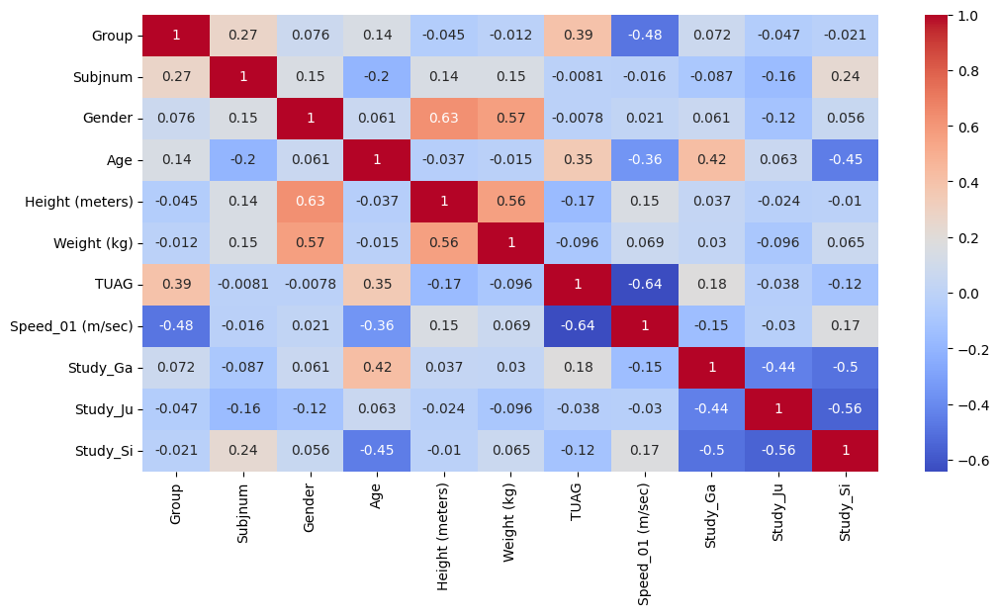

In [17]:
plt.figure(figsize=(12,6))
coll = ['Group','Subjnum','Gender','Age','Height (meters)','Weight (kg)','TUAG','Speed_01 (m/sec)','Study_Ga','Study_Ju','Study_Si']
corr = demo_encoded[coll].corr()

sns.heatmap(corr, cmap="coolwarm", annot=True)

As I mentioned, we can then drop TUAG because it is essentially the same as Speed 01 and has more missing values.

In [18]:
demo_encoded.drop(['Speed_10'],inplace=True,axis=1)

## Exploration

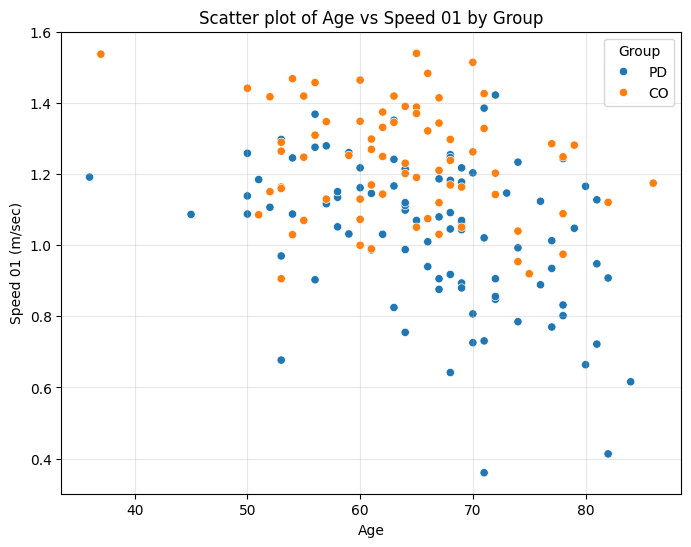

In [19]:

plt.figure(figsize=(8,6))
sns.scatterplot(
    data=demographics,
    x='Age',
    y='Speed_01 (m/sec)',
    hue='Group'
)

plt.xlabel("Age")
plt.ylabel("Speed 01 (m/sec)")
plt.title("Scatter plot of Age vs Speed 01 by Group")
plt.legend(title='Group')
plt.grid(alpha=0.3)
plt.show()

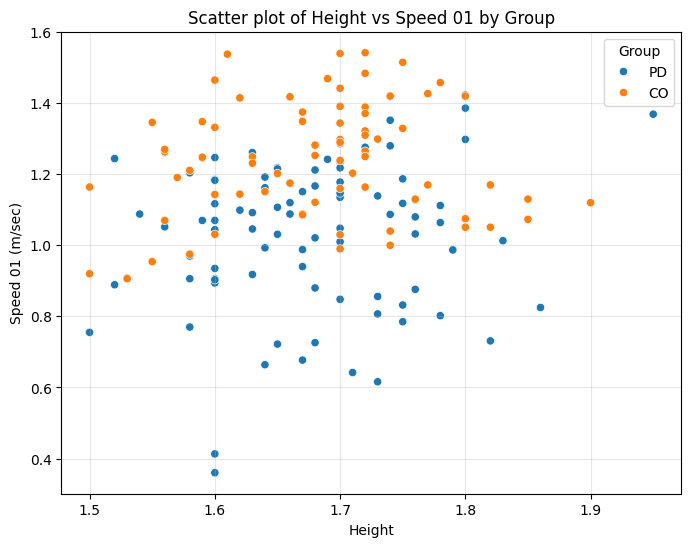

In [20]:
plt.figure(figsize=(8,6))
sns.scatterplot(
    data=demographics,
    x='Height (meters)',
    y='Speed_01 (m/sec)',
    hue='Group'
)

plt.xlabel("Height")
plt.ylabel("Speed 01 (m/sec)")
plt.title("Scatter plot of Height vs Speed 01 by Group")
plt.legend(title='Group')
plt.grid(alpha=0.3)
plt.show()

We can already see that a low Speed 01 seems to indicate that it' part of PD group

# End of Dataset Preparation

In [21]:
df = features.copy()
features = df.join(demo_encoded.set_index('ID'), on='patient', how='inner')

In [22]:
col =['Subjnum','TUAG', 'Study_Ga', 'Study_Ju', 'Study_Si','label']

features.drop(col,axis=1, inplace=True)
features.shape

(80, 23)

In [23]:
features.columns

Index(['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean',
       'force_diff_cv_global', 'force_diff_sym', 'double_support_mean',
       'double_support_cv', 'swing_cv', 'stance_cv', 'stance_swing_mean',
       'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean',
       'double_support_step_cv', 'double_support_step_log', 'patient', 'Group',
       'Gender', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_01 (m/sec)'],
      dtype='object')

In [24]:
features = features.drop(['patient','stance_cv','double_support_cv','swing_cv','double_support_step_log','stance_swing_mean','double_support_mean'],axis=1)
features.shape

(80, 16)

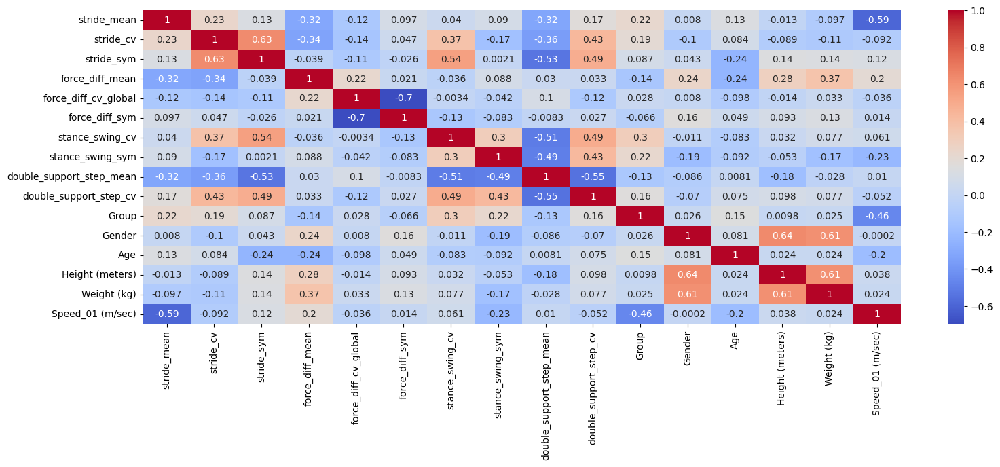

In [25]:
plt.figure(figsize=(18,6))


sns.heatmap(features.corr(), cmap="coolwarm", annot=True)
plt.show()

We can observe that the feature selection process aims to reduce the correlation between features. Even before applying the wrapper-based feature selection, the maximum correlation among the selected features is 0.64, which is acceptable.

# Outliers and visualising our Dataset

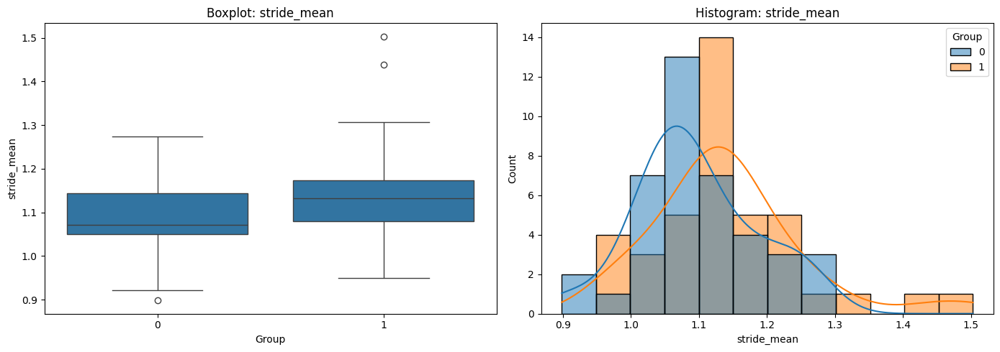

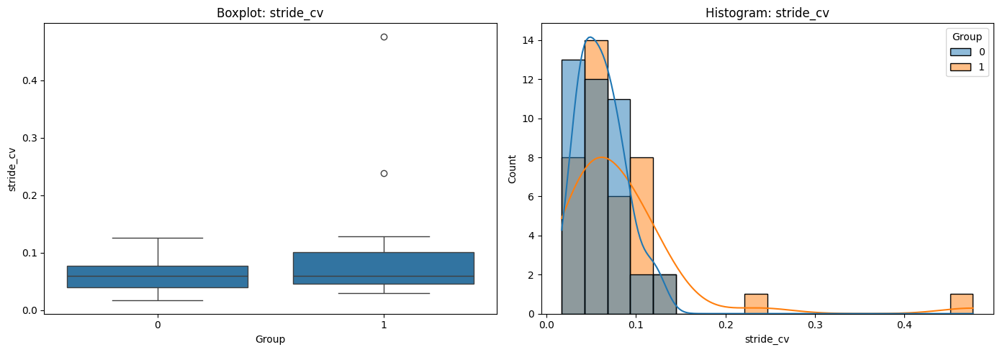

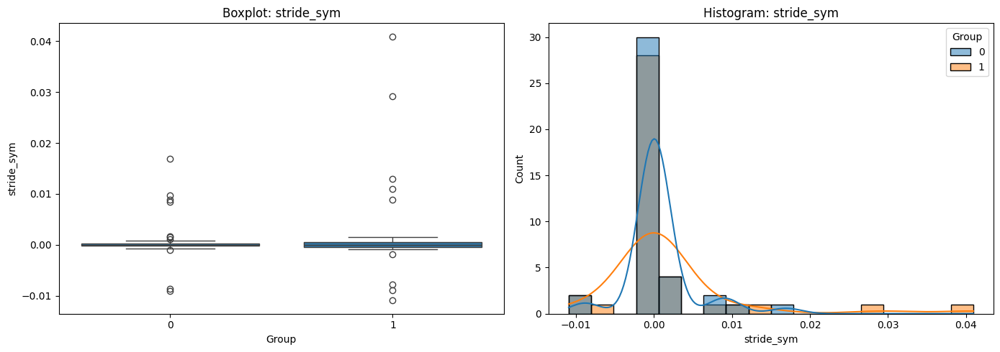

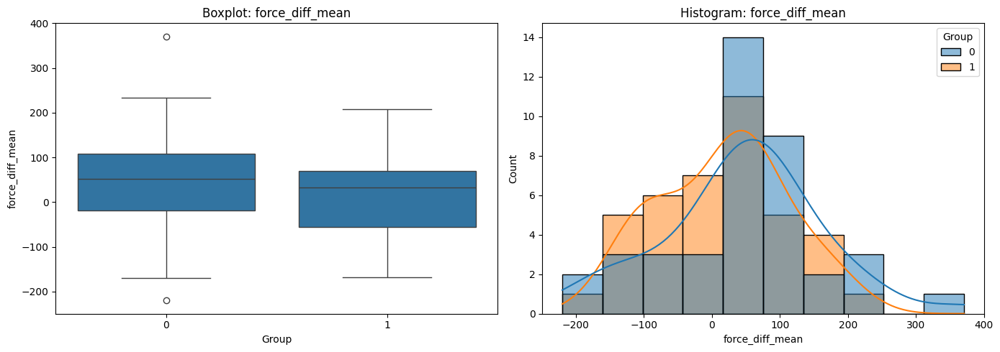

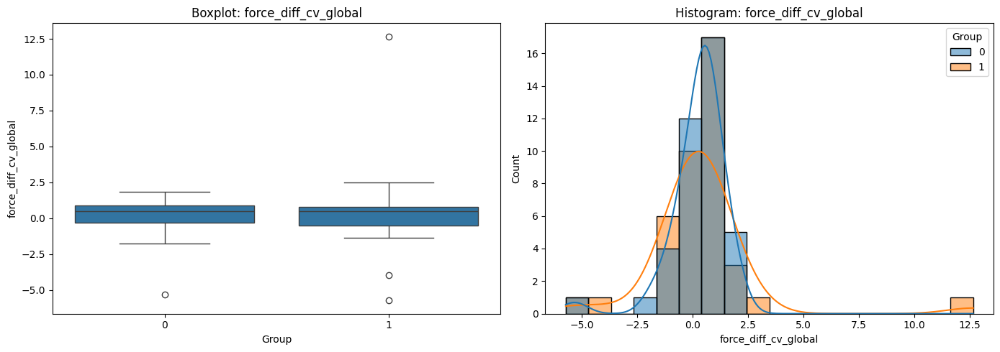

...

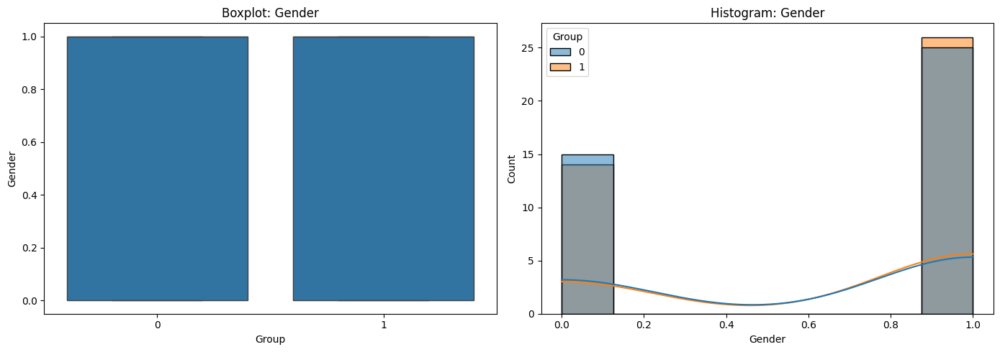

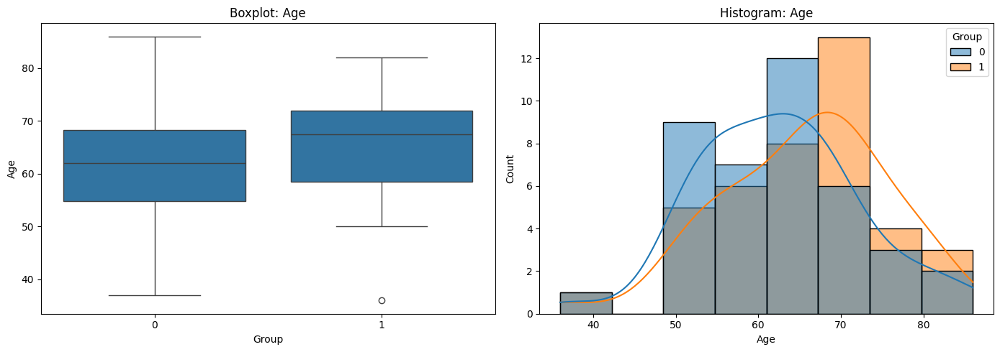

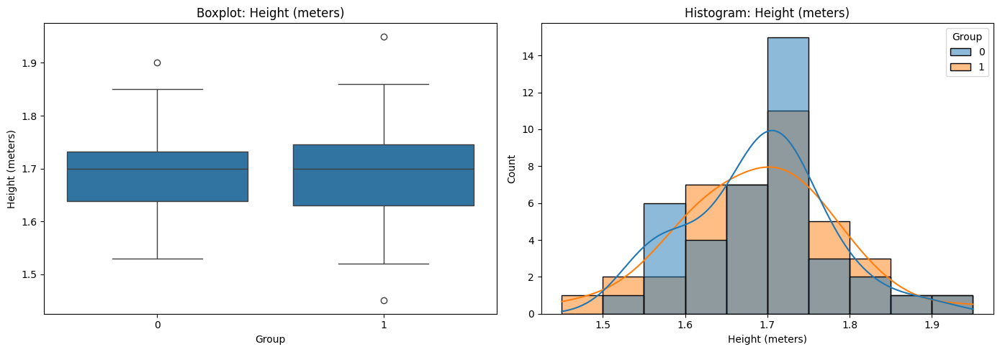

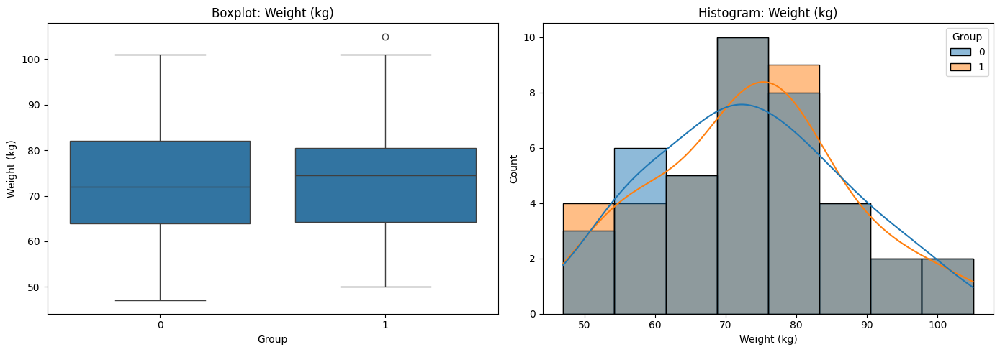

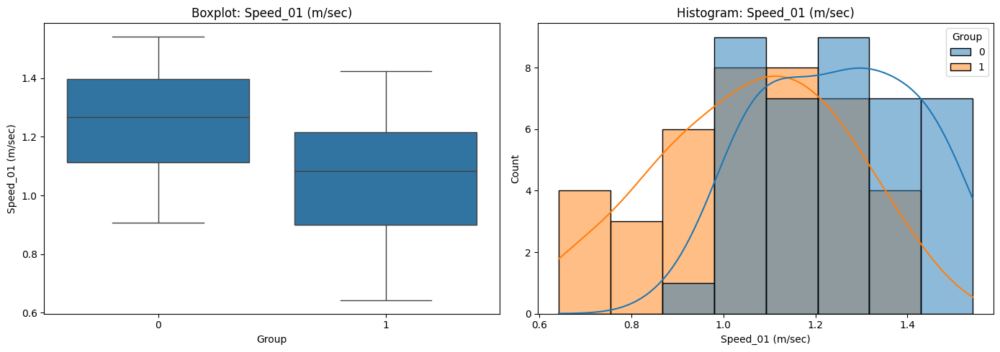

In [26]:
for col in features.columns:
    fig, axes = plt.subplots(1, 2, figsize=(14,5)) 

    sns.boxplot(x="Group", y=col, data=features, ax=axes[0])
    axes[0].set_title(f'Boxplot: {col}')

    sns.histplot(data=features, x=col, kde=True, ax=axes[1],hue="Group")
    axes[1].set_title(f'Histogram: {col}')

    plt.tight_layout()
    plt.show()



Based on the various plots, it may appear that there are some outliers in the data. To investigate this, we will identify a few of the largest outliers and examine their walking speed graphs to determine whether these values are genuine or abnormal.

{'stride_sym': [8, 18, 59, 74], 'force_diff_sym': [5]}


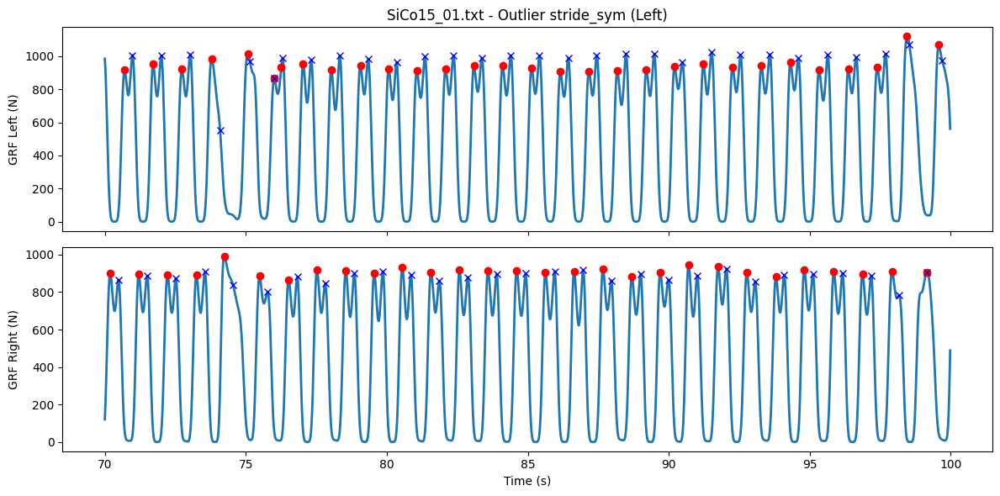

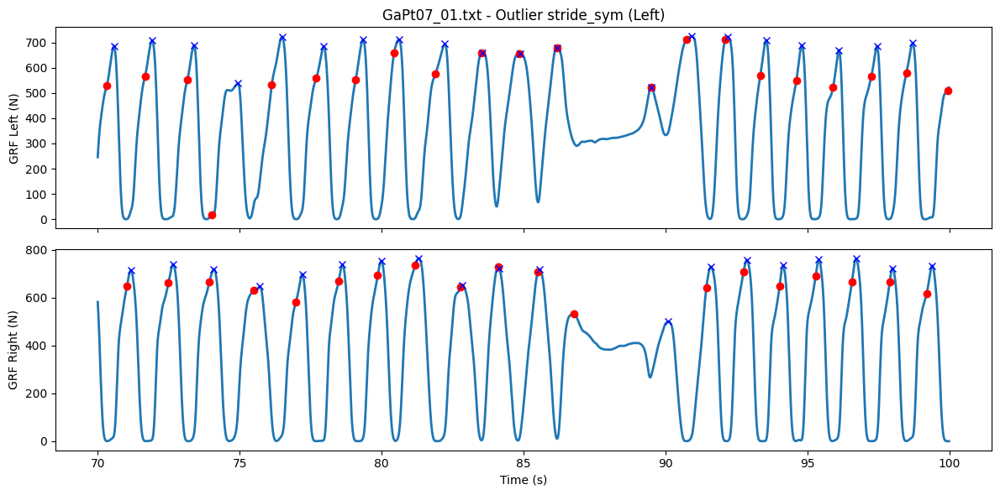

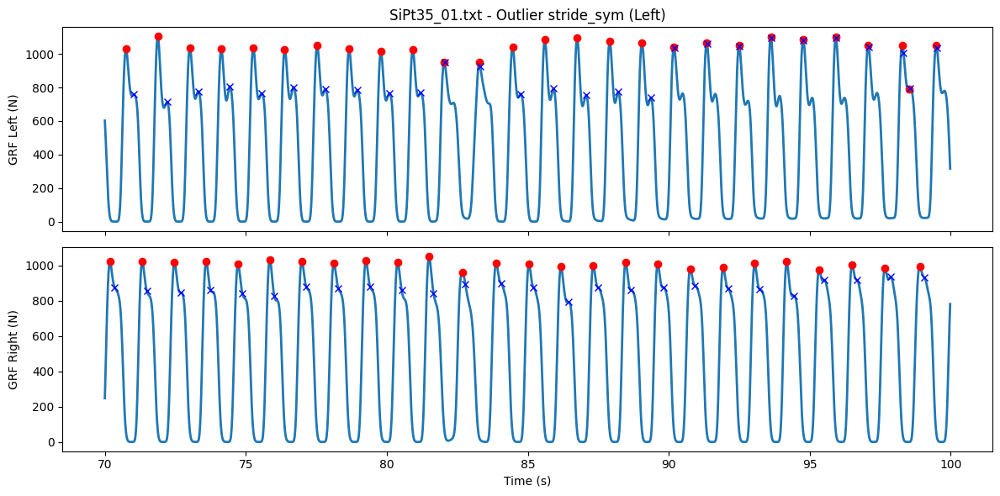

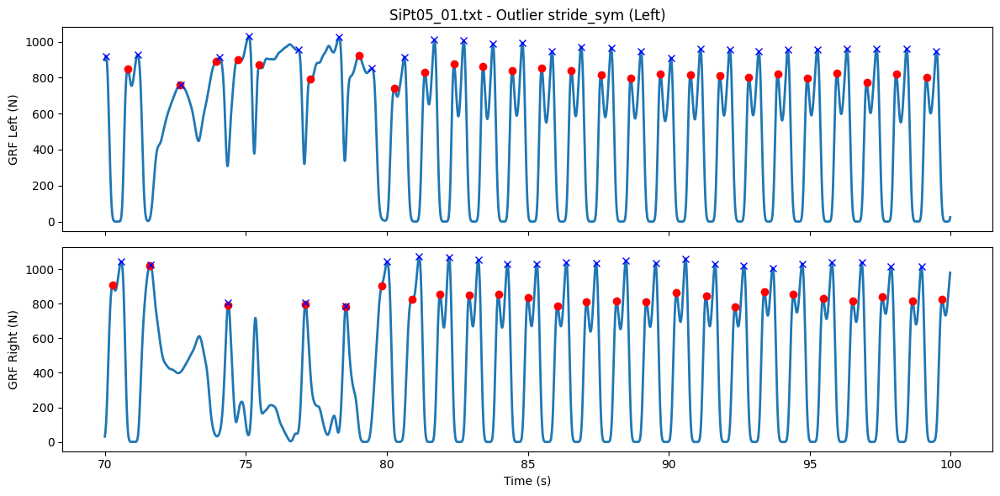

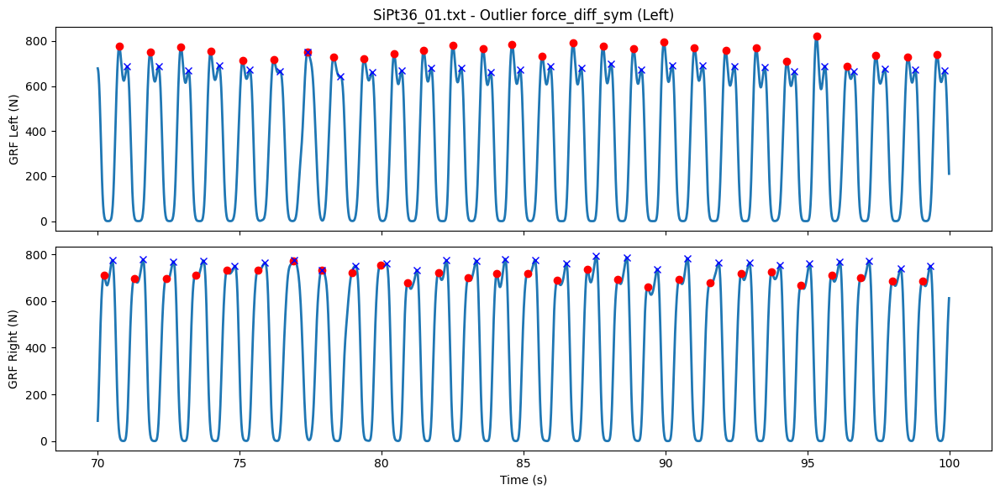

In [27]:
features_copy = features.copy()

k = 15  # multiplier for IQR to detect extreme outliers
outliers_dict = {}

# Loop through each feature to find outliers

for col in features_copy.columns:
    Q1 = features_copy[col].quantile(0.25)
    Q3 = features_copy[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - k * IQR
    upper = Q3 + k * IQR

    outlier_idx = features_copy[(features_copy[col] < lower) | (features_copy[col] > upper)].index
    if len(outlier_idx) > 0:
        outliers_dict[col] = outlier_idx.tolist()

print(outliers_dict)

# Plot the walking signals for each outlier

for col, indices in outliers_dict.items():
    for i in indices:
        data = patient_data[i]
        fig, axes = plt.subplots(2,1, figsize=(12,6), sharex=True)
        
        # Select a segment of the signal to plot
        x0 = 7000
        xlim_max = 10000
        time_L = data["time"][x0:xlim_max]
        signal_L = data["signal_smooth_L"][x0:xlim_max]


        heel_peaks_L = data["heel_peaks_L"][(data["heel_peaks_L"] > x0) & (data["heel_peaks_L"] < xlim_max)]
        toe_peaks_L  = data["toe_peaks_L"][(data["toe_peaks_L"] > x0) & (data["toe_peaks_L"] < xlim_max)]

        time_R = data["time"][x0:xlim_max]
        signal_R = data["signal_smooth_R"][x0:xlim_max]

        heel_peaks_R = data["heel_peaks_R"][(data["heel_peaks_R"] > x0) & (data["heel_peaks_R"] < xlim_max)]
        toe_peaks_R  = data["toe_peaks_R"][(data["toe_peaks_R"] > x0) & (data["toe_peaks_R"] < xlim_max)]


        axes[1].plot(time_R, signal_R, linewidth=2)
        axes[1].plot(data["time"][heel_peaks_R], data["signal_smooth_R"][heel_peaks_R], 'ro')
        axes[1].plot(data["time"][toe_peaks_R], data["signal_smooth_R"][toe_peaks_R], 'bx')


        axes[0].plot(time_L, signal_L, linewidth=2)
        axes[0].plot(data["time"][heel_peaks_L], data["signal_smooth_L"][heel_peaks_L], 'ro')
        axes[0].plot(data["time"][toe_peaks_L], data["signal_smooth_L"][toe_peaks_L], 'bx')
        axes[0].set_title(f"{data['filename']} - Outlier {col} (Left)")
        axes[0].set_ylabel("GRF Left (N)")

        axes[1].set_xlabel("Time (s)")
        axes[1].set_ylabel("GRF Right (N)")

        plt.tight_layout()
        plt.show()

By looking at the walking signals, we can observe that some apparent outliers may be due to detection errors. However, this is mainly because most of the samples belong to the PD group, whose gait is naturally irregular. Therefore, these extreme values are expected, and there is no need to remove them.

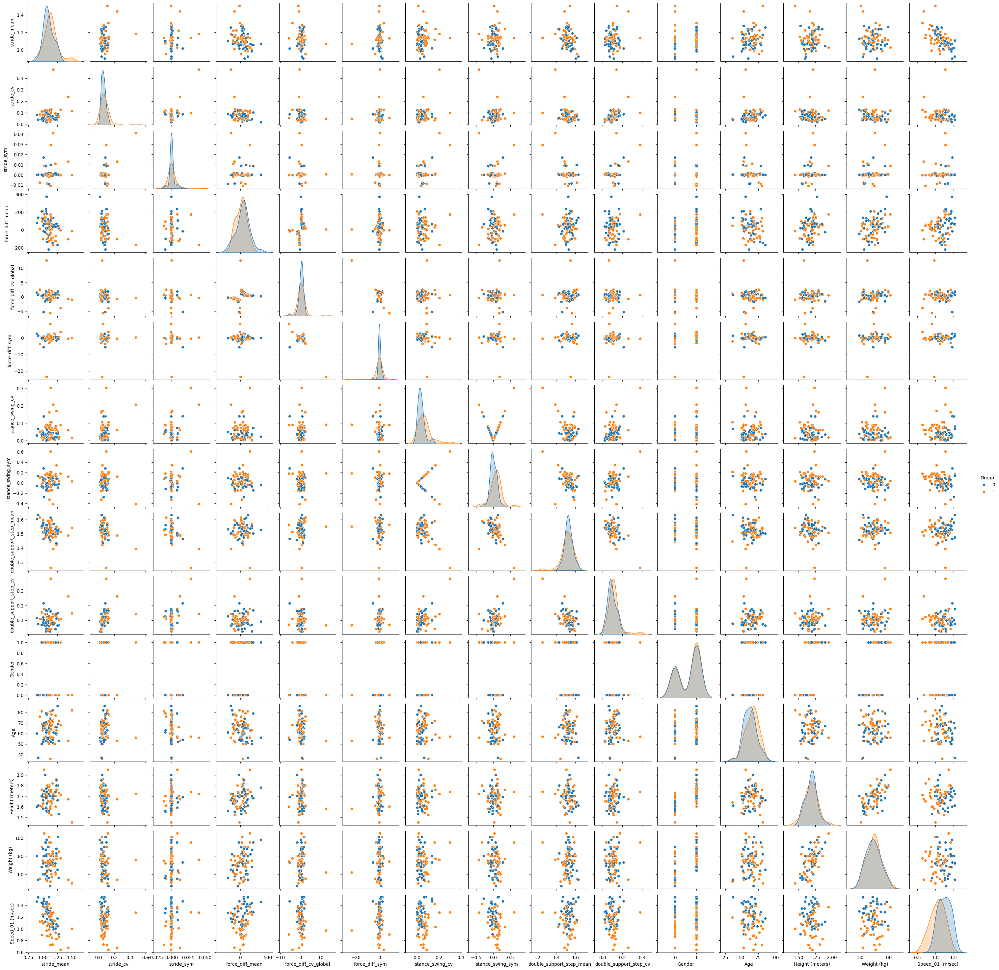

In [28]:
sns.pairplot(
    features,
    vars=['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean',
          'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv',
          'stance_swing_sym', 'double_support_step_mean',
          'double_support_step_cv', 'Gender', 'Age', 'Height (meters)',
          'Weight (kg)', 'Speed_01 (m/sec)'],
    hue='Group',
    height=2,   
    aspect=1  
)

plt.show()


In [29]:
summary = features.groupby('Group')[['stride_mean', 'stride_cv', 'stride_sym']].agg(['mean', 'max', 'min', 'std', 'median'])
summary = summary.T
summary

Group                      0         1
stride_mean mean    1.095225  1.140727
            max     1.273405  1.502975
            min     0.898189  0.949602
            std     0.088636  0.110557
            median  1.072136  1.132381
stride_cv   mean    0.061574  0.083648
            max     0.125719  0.476551
            min     0.016978  0.030262
            std     0.026203  0.075276
            median  0.059555  0.059702
stride_sym  mean    0.000720  0.001907
            max     0.016944  0.040931
            min    -0.009080 -0.010918
            std     0.004165  0.008801
            median -0.000037 -0.000013

In [30]:
summary = features.groupby('Group')[['force_diff_mean', 'force_diff_cv_global', 'force_diff_sym']].agg(['mean', 'max', 'min', 'std', 'median'])
summary = summary.T
summary

Group                                 0           1
force_diff_mean      mean     45.343776   16.357782
                     max     370.551540  207.517299
                     min    -219.704848 -168.048718
                     std     117.121257   93.618670
                     median   52.021025   32.035410
force_diff_cv_global mean      0.254157    0.362571
                     max       1.854785   12.665505
                     min      -5.320482   -5.717110
                     std       1.237485    2.477231
                     median    0.500130    0.499731
force_diff_sym       mean     -0.096133   -0.497684
                     max       2.546213    8.340428
                     min      -5.619851  -23.534425
                     std       1.298103    4.175406
                     median   -0.096014   -0.087818

In [31]:
summary = features.groupby('Group')[['stance_swing_cv', 'stance_swing_sym','double_support_step_mean', 'double_support_step_cv']].agg(['mean', 'max', 'min', 'std', 'median'])
summary = summary.T
summary

Group                                   0         1
stance_swing_cv          mean    0.037529  0.067193
                         max     0.139341  0.303206
                         min     0.000123  0.002237
                         std     0.030873  0.059783
                         median  0.034094  0.060548
stance_swing_sym         mean    0.003239  0.065100
                         max     0.278682  0.606411
                         min    -0.276877 -0.412501
                         std     0.097876  0.168736
                         median -0.014570  0.087120
double_support_step_mean mean    1.529629  1.516301
                         max     1.631735  1.614656
                         min     1.433181  1.259584
                         std     0.041341  0.063218
                         median  1.527516  1.519351
double_support_step_cv   mean    0.097579  0.114700
                         max     0.214634  0.381946
                         min     0.023126  0.027805
                         std     0.044480  0.059047
                         median  0.086035  0.109533

In [32]:
summary = features.groupby('Group')[['Age', 'Height (meters)','Weight (kg)','Speed_01 (m/sec)']].agg(['mean', 'max', 'min', 'std', 'median'])
summary = summary.T
summary

Group                             0           1
Age              mean     62.425000   65.425000
                 max      86.000000   82.000000
                 min      37.000000   36.000000
                 std       9.768835   10.068706
                 median   62.000000   67.500000
Height (meters)  mean      1.687500    1.689228
                 max       1.900000    1.950000
                 min       1.530000    1.450000
                 std       0.082981    0.095892
                 median    1.700000    1.700000
Weight (kg)      mean     73.221094   73.888596
                 max     101.000000  105.000000
                 min      47.000000   50.000000
                 std      13.396870   13.454637
                 median   72.000000   74.500000
Speed_01 (m/sec) mean      1.250850    1.061093
                 max       1.542000    1.423000
                 min       0.906000    0.642000
                 std       0.170634    0.200847
                 median    1.266500    1.084000

# Re-scaling

In [34]:
groups = features['Group']

scaler = MinMaxScaler()
features_scaled = pd.DataFrame(
    scaler.fit_transform(features.drop('Group', axis=1)),
    columns=features.drop('Group', axis=1).columns
)

features_scaled['Group'] = groups.values

summary = (
    features_scaled
    .groupby('Group')[['stride_mean', 'stride_cv', 'stride_sym']]
    .agg(['mean', 'max', 'min', 'std', 'median'])
    .T  )

summary

Group                      0         1
stride_mean mean    0.325795  0.401031
            max     0.620412  1.000000
            min     0.000000  0.085010
            std     0.146557  0.182804
            median  0.287618  0.387232
stride_cv   mean    0.097039  0.145069
            max     0.236613  1.000000
            min     0.000000  0.028906
            std     0.057017  0.163796
            median  0.092645  0.092965
stride_sym  mean    0.224457  0.247353
            max     0.537357  1.000000
            min     0.035453  0.000000
            std     0.080330  0.169737
            median  0.209854  0.210320

In [35]:
summary = (
    features_scaled
    .groupby('Group')[['stance_swing_cv', 'stance_swing_sym','double_support_step_mean', 'double_support_step_cv']]
    .agg(['mean', 'max', 'min', 'std', 'median'])
    .T  
)

summary

Group                                   0         1
stance_swing_cv          mean    0.123418  0.221292
                         max     0.459341  1.000000
                         min     0.000000  0.006975
                         std     0.101862  0.197250
                         median  0.112085  0.199370
stance_swing_sym         mean    0.408023  0.468737
                         max     0.678354  1.000000
                         min     0.133107  0.000000
                         std     0.096060  0.165604
                         median  0.390545  0.490348
double_support_step_mean mean    0.725631  0.689818
                         max     1.000000  0.954106
                         min     0.466468  0.000000
                         std     0.111085  0.169872
                         median  0.719953  0.698014
double_support_step_cv   mean    0.207492  0.255209
                         max     0.533715  1.000000
                         min     0.000000  0.013040
                         std     0.123961  0.164558
                         median  0.175321  0.240808

In [36]:
summary = (
    features_scaled
    .groupby('Group')[['Age', 'Height (meters)','Weight (kg)','Speed_01 (m/sec)']]
    .agg(['mean', 'max', 'min', 'std', 'median'])
    .T  
)

summary

Group                           0         1
Age              mean    0.528500  0.588500
                 max     1.000000  0.920000
                 min     0.020000  0.000000
                 std     0.195377  0.201374
                 median  0.520000  0.630000
Height (meters)  mean    0.475000  0.478456
                 max     0.900000  1.000000
                 min     0.160000  0.000000
                 std     0.165963  0.191785
                 median  0.500000  0.500000
Weight (kg)      mean    0.452088  0.463596
                 max     0.931034  1.000000
                 min     0.000000  0.051724
                 std     0.230981  0.231976
                 median  0.431034  0.474138
Speed_01 (m/sec) mean    0.676500  0.465659
                 max     1.000000  0.867778
                 min     0.293333  0.000000
                 std     0.189594  0.223163
                 median  0.693889  0.491111

# KNN


  Testing K = 1

Fold 1/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.500, F1: 0.500, AUC: 0.533

Fold 2/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.750, F1: 0.750, AUC: 0.750

Fold 3/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.500, F1: 0.500, AUC: 0.533

Fold 4/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.625, F1: 0.667, AUC: 0.633

Fold 5/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.750, F1: 0.667, AUC: 0.733

Fold 6/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.750, F1: 0.667, AUC: 0.733

Fold 7/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.750, F1: 0.750, AUC: 0.750

Fold 8/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.625, F1: 0.667, AUC: 0.633

Fold 9/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.625, F1: 0.400, AUC: 0.567

Fold 10/10
  Features sélectionnées: ['Speed_01 (m/sec)']
  Accuracy: 0.250, F1: 0.400, AUC

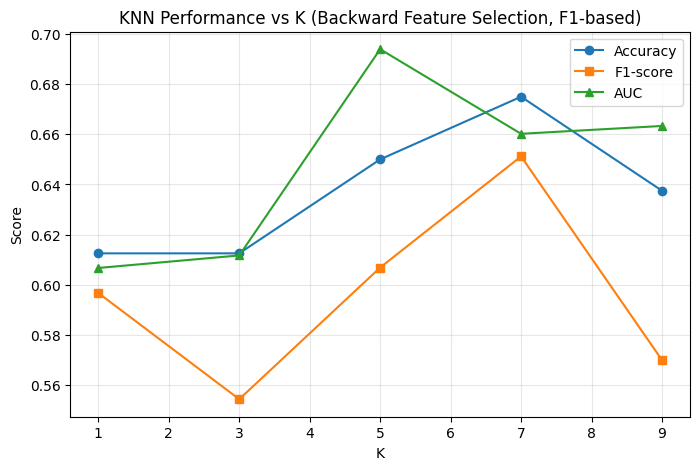

In [37]:
y = features.Group
X = features.drop(['Group'],axis = 1)

k_values = [1, 3, 5, 7, 9]
numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True, random_state=42)



feature_names = list(X.columns)  
X = X.values                    
Y = np.array(Y)

results = {}


# Loop over K

for k in k_values:
    print(f"\n============================")
    print(f"  Testing K = {k}")
    print(f"============================")

    acc_list = []
    f1_list = []
    auc_list = []

    
    # Cross-Validation Loop
    
    for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
        print(f"\nFold {fold}/{numFolds}")

        # Split
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = Y[train_idx], Y[test_idx]

        # Normalisation
        scaler = MinMaxScaler().fit(X_train)
        X_train = scaler.transform(X_train)
        X_test = scaler.transform(X_test)

        
        selected_features = feature_names.copy()

        feature_idx = [feature_names.index(f) for f in selected_features]
        model = KNeighborsClassifier(n_neighbors=k)
        model.fit(X_train[:, feature_idx], y_train)
        y_pred = model.predict(X_train[:, feature_idx])
        best_f1 = f1_score(y_train, y_pred)

        # Run feature selection using training data

        while len(selected_features) > 1:
            scores = []
            for feat in selected_features:
                trial_features = [f for f in selected_features if f != feat]
                trial_idx = [feature_names.index(f) for f in trial_features]

                model = KNeighborsClassifier(n_neighbors=k)
                model.fit(X_train[:, trial_idx], y_train)
                y_pred = model.predict(X_train[:, trial_idx])
                f1 = f1_score(y_train, y_pred)
                scores.append((feat, f1))

            # Find the feature whose removal improves F1 the most
            best_feat, feat_f1 = max(scores, key=lambda x: x[1])

            if feat_f1 >= best_f1:
                best_f1 = feat_f1
                selected_features.remove(best_feat)
            else:
                break

        print(f"  Features sélectionnées: {selected_features}")

        # Train model using selected features and “train” data for this fold, and required hyperparameters
        feature_idx = [feature_names.index(f) for f in selected_features]
        model = KNeighborsClassifier(n_neighbors=k)
        model.fit(X_train[:, feature_idx], y_train)

        # Evaluate model using “test” sample
        y_pred = model.predict(X_test[:, feature_idx])
        y_prob = model.predict_proba(X_test[:, feature_idx])[:, 1]

        acc = accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        auc = roc_auc_score(y_test, y_prob)

        acc_list.append(acc)
        f1_list.append(f1)
        auc_list.append(auc)

        print(f"  Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")


    # Mean over the folds

    results[k] = {
        'mean_acc': np.mean(acc_list),
        'std_acc': np.std(acc_list),
        'mean_f1': np.mean(f1_list),
        'std_f1': np.std(f1_list),
        'mean_auc': np.mean(auc_list),
        'std_auc': np.std(auc_list)
    }

    print("\n---------------------------")
    print(f"K = {k}")
    print(f"Mean Accuracy: {results[k]['mean_acc']:.3f} ± {results[k]['std_acc']:.3f}")
    print(f"Mean F1-score: {results[k]['mean_f1']:.3f} ± {results[k]['std_f1']:.3f}")
    print(f"Mean AUC     : {results[k]['mean_auc']:.3f} ± {results[k]['std_auc']:.3f}")
    print("---------------------------")


print("\n==================== Summary ====================")
print("K    MeanAcc            MeanF1          MeanAUC")
for k in k_values:
    r = results[k]
    print(f"{k:<4} {r['mean_acc']:.3f} ± {r['std_acc']:.3f}  {r['mean_f1']:.3f} ± {r['std_f1']:.3f}    {r['mean_auc']:.3f} ± {r['std_auc']:.3f} ")
    #print(f"{k:<4} {}    {r['std_f1']:.3f}    {r['std_auc']:.3f}")

# Plot

plt.figure(figsize=(8, 5))
plt.plot(k_values, [results[k]['mean_acc'] for k in k_values], marker='o', label='Accuracy')
plt.plot(k_values, [results[k]['mean_f1'] for k in k_values], marker='s', label='F1-score')
plt.plot(k_values, [results[k]['mean_auc'] for k in k_values], marker='^', label='AUC')
plt.xlabel('K')
plt.ylabel('Score')
plt.title('KNN Performance vs K (Backward Feature Selection, F1-based)')
plt.grid(alpha=0.3)
plt.legend()
plt.show()


For K=1, only the feature Speed_01 (m/sec) is selected, and the model achieves moderate performance, with a mean accuracy of 0.613, F1-score of 0.597, and AUC of 0.607. 
This is expected, as the model relies solely on the closest neighbor for predictions. 

As K increases to 3, 5, 7, and 9, more features are included, and the model generally shows slight improvements in performance. The highest F1-score is observed at K=7 (0.651), while the highest AUC is reached at K=5 (0.694). However, variability across folds remains notable, particularly for K=1 and K=9, reflecting sensitivity to individual samples. Overall, increasing K allows the model to incorporate more neighbors and features, capturing additional information without a strict monotonic improvement. 

K=7 appears to offer the best balance between accuracy and F1, indicating that moderate K values effectively leverage multiple features while mitigating overfitting to single neighbors.

In [38]:
# Select k = 7
k = 7
numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True, random_state=42)
y = features.Group
X = features.drop(['Group'],axis = 1)

feature_names = list(X.columns)  
X = X.values                    
Y = np.array(Y)

results_weights = {}
acc_list = []
f1_list = []
auc_list = []


# Cross-Validation Loop

for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
    print(f"\nFold {fold}/{numFolds}")

    # Split
    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = Y[train_idx], Y[test_idx]

    # Normalisation
    scaler = MinMaxScaler().fit(X_train)
    X_train = scaler.transform(X_train)
    X_test = scaler.transform(X_test)

   
    selected_features = feature_names.copy()

    feature_idx = [feature_names.index(f) for f in selected_features]
    model = KNeighborsClassifier(n_neighbors=k, weights='distance')
    model.fit(X_train[:, feature_idx], y_train)
    y_pred = model.predict(X_train[:, feature_idx])
    best_f1 = f1_score(y_train, y_pred)
    
    

    # Run feature selection using training data
    while len(selected_features) > 1:
        scores = []
        for feat in selected_features:
            trial_features = [f for f in selected_features if f != feat]
            trial_idx = [feature_names.index(f) for f in trial_features]

            model = KNeighborsClassifier(n_neighbors=k,weights='distance')
            model.fit(X_train[:, trial_idx], y_train)
            y_pred = model.predict(X_train[:, trial_idx])
            f1 = f1_score(y_train, y_pred)
            scores.append((feat, f1))

        # Find the feature whose removal improves F1 the most
        best_feat, feat_f1 = max(scores, key=lambda x: x[1])

        if feat_f1 >= best_f1:
            best_f1 = feat_f1
            selected_features.remove(best_feat)
        else:
            break

    print(f"  Features selected: {selected_features}")
    print("best score=",best_f1)

    # Train model using selected features and “train” data for this fold
    feature_idx = [feature_names.index(f) for f in selected_features]
    model = KNeighborsClassifier(n_neighbors=k,weights='distance')
    model.fit(X_train[:, feature_idx], y_train)

    # Evaluate model using “test” sample
    y_pred = model.predict(X_test[:, feature_idx])
    y_prob = model.predict_proba(X_test[:, feature_idx])[:, 1]

    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    acc_list.append(acc)
    f1_list.append(f1)
    auc_list.append(auc)

    print(f"  Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")


# Calculate average performance metric

results_weights[k] = {
    'mean_acc': np.mean(acc_list),
    'std_acc': np.std(acc_list),
    'mean_f1': np.mean(f1_list),
    'std_f1': np.std(f1_list),
    'mean_auc': np.mean(auc_list),
    'std_auc':np.std(auc_list)
}

print("\n---------------------------")
print(f"K = {k}")
print(f"Mean Accuracy: {results_weights[k]['mean_acc']:.3f} ± {results_weights[k]['std_acc']:.3f}")
print(f"Mean F1-score: {results_weights[k]['mean_f1']:.3f} ± {results_weights[k]['std_f1']:.3f}")
print(f"Mean AUC     : {results_weights[k]['mean_auc']:.3f} ± {results_weights[k]['std_auc']:.3f}")
print("---------------------------")


print("\n========== Summary ==========")
print("K    MeanAcc   MeanF1   MeanAUC")

r = results_weights[k]
print(f"{k:<4} {r['mean_acc']:.3f} ± {r['std_acc']:.3f}  {r['mean_f1']:.3f} ± {r['std_f1']:.3f}    {r['mean_auc']:.3f} ± {r['std_auc']:.3f} ")



Fold 1/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.500, F1: 0.500, AUC: 0.800

Fold 2/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.625, F1: 0.571, AUC: 0.812

Fold 3/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.625, F1: 0.667, AUC: 0.733

Fold 4/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.375, F1: 0.286, AUC: 0.733

Fold 5/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.625, F1: 0.571, AUC: 0.667

Fold 6/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.750, F1: 0.667, AUC: 0.600

Fold 7/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.750, F1: 0.800, AUC: 0.812

Fold 8/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.750, F1: 0.750, AUC: 0.733

Fold 9/10
  Features selected: ['Speed_01 (m/sec)']
best score= 1.0
  Accuracy: 0.625, F1: 0.400, AUC: 0.467

Fold 10/1

When we use the weight, we have a problem on the wrapper selection : the model overfitt so the best score is 1. Thus, only one feature is selected. For this reason, we can try to put an other cross validation to avoid the overfitting problem.

In [39]:
# Select k = 7
k = 7
numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True, random_state=42)

y = features.Group
X = features.drop(['Group'],axis = 1)
feature_names = list(X.columns)  
X = X.values                    
Y = np.array(Y)

results_weights = {}
acc_list = []
f1_list = []
auc_list = []

# Cross-Validation Loop
for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
    print(f"\nFold {fold}/{numFolds}")

    # Split
    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = Y[train_idx], Y[test_idx]

    # Normalisation
    scaler = MinMaxScaler().fit(X_train)
    X_train = scaler.transform(X_train)
    X_test = scaler.transform(X_test)

    selected_features = feature_names.copy()

    feature_idx = [feature_names.index(f) for f in selected_features]
    model = KNeighborsClassifier(n_neighbors=k, weights='distance')
    # Best idea of a "real" f1 score to avoid overfitting
    best_f1 = cross_val_score(
        model, 
        X_train[:, feature_idx], 
        y_train, 
        cv=5, 
        scoring='f1'
    ).mean()
    

    # Run feature selection using training data
    while len(selected_features) > 1:
        scores = []
        for feat in selected_features:
            trial_features = [f for f in selected_features if f != feat]
            trial_idx = [feature_names.index(f) for f in trial_features]

            model = KNeighborsClassifier(n_neighbors=k, weights='distance')
            
            # evaluation with CV to avoid overfitting
            f1 = cross_val_score(
                model, 
                X_train[:, trial_idx], 
                y_train, 
                cv=5, 
                scoring='f1'
            ).mean()
            
            scores.append((feat, f1))

        # Find the feature whose removal improves F1 the most
        best_feat, feat_f1 = max(scores, key=lambda x: x[1])

        if feat_f1 >= best_f1:
            best_f1 = feat_f1
            selected_features.remove(best_feat)
        else:
            break

    print(f"  Features selected: {selected_features}")
    print(f"  Number of features selected: {len(selected_features)}")
    print(f"  Best F1 (CV): {best_f1:.3f}")

    # Train model using selected features and "train" data for this fold
    feature_idx = [feature_names.index(f) for f in selected_features]
    model = KNeighborsClassifier(n_neighbors=k, weights='distance')
    model.fit(X_train[:, feature_idx], y_train)

    # Evaluate model using "test" sample
    y_pred = model.predict(X_test[:, feature_idx])
    y_prob = model.predict_proba(X_test[:, feature_idx])[:, 1]

    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    acc_list.append(acc)
    f1_list.append(f1)
    auc_list.append(auc)

    print(f"  Test - Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")

# Calculate average performance metric
results_weights[k] = {
    'mean_acc': np.mean(acc_list),
    'std_acc': np.std(acc_list),
    'mean_f1': np.mean(f1_list),
    'std_f1': np.std(f1_list),
    'mean_auc': np.mean(auc_list),
    'std_auc': np.std(auc_list)
}

print("\n---------------------------")
print(f"K = {k}")
print(f"Mean Accuracy: {results_weights[k]['mean_acc']:.3f} ± {results_weights[k]['std_acc']:.3f}")
print(f"Mean F1-score: {results_weights[k]['mean_f1']:.3f} ± {results_weights[k]['std_f1']:.3f}")
print(f"Mean AUC     : {results_weights[k]['mean_auc']:.3f}")
print("---------------------------")


print("\n========== Summary ==========")
print("K    MeanAcc   MeanF1   MeanAUC")

r = results_weights[k]
print(f"{k:<4} {r['mean_acc']:.3f} ± {r['std_acc']:.3f}  {r['mean_f1']:.3f} ± {r['std_f1']:.3f}    {r['mean_auc']:.3f} ± {r['std_auc']:.3f} ")




Fold 1/10
  Features selected: ['stride_mean', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'stance_swing_cv', 'stance_swing_sym', 'Gender', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_01 (m/sec)']
  Number of features selected: 11
  Best F1 (CV): 0.636
  Test - Accuracy: 0.250, F1: 0.250, AUC: 0.467

Fold 2/10
  Features selected: ['force_diff_mean', 'force_diff_sym', 'stance_swing_cv', 'double_support_step_cv', 'Age', 'Height (meters)', 'Speed_01 (m/sec)']
  Number of features selected: 7
  Best F1 (CV): 0.666
  Test - Accuracy: 0.750, F1: 0.667, AUC: 1.000

Fold 3/10
  Features selected: ['stride_mean', 'force_diff_mean', 'force_diff_cv_global', 'stance_swing_cv', 'stance_swing_sym', 'Age', 'Weight (kg)', 'Speed_01 (m/sec)']
  Number of features selected: 8
  Best F1 (CV): 0.687
  Test - Accuracy: 0.750, F1: 0.667, AUC: 0.867

Fold 4/10
  Features selected: ['stride_mean', 'force_diff_mean', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_st

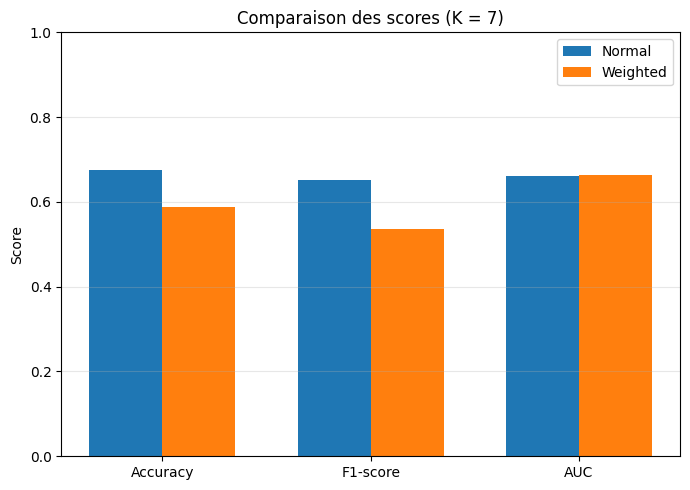

In [40]:
k_selected = 7



metrics = ['mean_acc', 'mean_f1', 'mean_auc']
metric_labels = ['Accuracy', 'F1-score', 'AUC']

normal = [results[k_selected][m] for m in metrics]
weighted = [results_weights[k_selected][m] for m in metrics]


x = np.arange(len(metrics))
width = 0.35

plt.figure(figsize=(7, 5))
plt.bar(x - width/2, normal, width, label='Normal')
plt.bar(x + width/2, weighted, width, label='Weighted')

plt.xticks(x, metric_labels)
plt.ylabel('Score')
plt.ylim(0, 1)  
plt.title(f'Comparaison des scores (K = {k_selected})')
plt.legend()
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

The use of distance weighting (weights='distance') does not appear to significantly improve performance compared to uniform voting, suggesting that in this context, the k nearest neighbors contribute relatively homogeneously to classification, regardless of their exact distance. It is important to note that feature selection is performed via nested cross-validation, which, combined with the small sample size (n=80), can induce substantial variance in the results despite our efforts to limit it. This instability is reflected in the variability of features selected across different folds and may partly explain the observed performance discrepancies.

# SVM AUTO


Testing SVM with C = 0.1
Number of feature selectionned : 15
Fold 1: Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Gender', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_01 (m/sec)']

Accuracy: 0.375, F1: 0.000, AUC: 0.300
Number of feature selectionned : 15
Fold 2: Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Gender', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_01 (m/sec)']

Accuracy: 0.750, F1: 0.750, AUC: 0.125
Number of feature selectionned : 14
Fold 3: Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean'

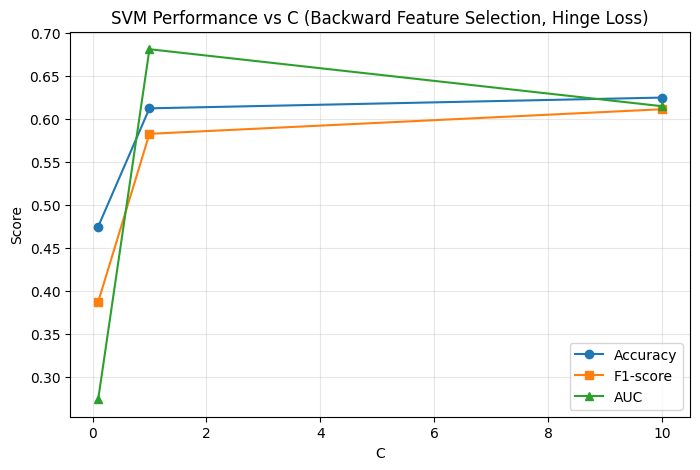

In [47]:

y = features.Group
X = features.drop(['Group'],axis = 1)

# Parameters

C_values = [0.1, 1, 10]
numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True, random_state=42)


feature_names = list(X.columns)
X = X.values
Y = np.array(Y)

Y_svm = np.where(Y == 0, -1, 1)

results = {}

# Loop over C

for C in C_values:
    print(f"\n============================")
    print(f"Testing SVM with C = {C}")
    print(f"============================")

    acc_list = []
    f1_list = []
    auc_list = []

    # Cross-Validation Loop

    for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = Y[train_idx], Y[test_idx]
        y_train_svm = Y_svm[train_idx]

        #  Normalisation
        scaler = MinMaxScaler().fit(X_train)
        X_train = scaler.transform(X_train)
        X_test = scaler.transform(X_test)

        # Run feature selection using training data and the loss of SVM
        selected_features = feature_names.copy()

        feature_idx = [feature_names.index(f) for f in selected_features]
        model = SVC(C=C, kernel='linear', random_state=42)
        model.fit(X_train[:, feature_idx], y_train_svm)
        scores = model.decision_function(X_train[:, feature_idx])
        best_loss = np.mean(np.maximum(0, 1 - y_train_svm * scores))

        while len(selected_features) > 1:
            trial_losses = []
            for feat in selected_features:
                trial_features = [f for f in selected_features if f != feat]
                trial_idx = [feature_names.index(f) for f in trial_features]

                model = SVC(C=C, kernel='linear', random_state=42)
                model.fit(X_train[:, trial_idx], y_train_svm)
                scores = model.decision_function(X_train[:, trial_idx])
                loss = np.mean(np.maximum(0, 1 - y_train_svm * scores))
                trial_losses.append((feat, loss))

            best_feat, feat_loss = min(trial_losses, key=lambda x: x[1])

            # Find the feature whose removal reduce the loss the less

            if feat_loss < best_loss:
                best_loss = feat_loss
                selected_features.remove(best_feat)
            else:
                break
        print("Number of feature selectionned :",len(selected_features))
        print(f"Fold {fold}: Features selected: {selected_features}")
        print()

        # Train model using selected features and “train” data for this fold
        feature_idx = [feature_names.index(f) for f in selected_features]
        model = SVC(C=C, kernel='linear', random_state=42, probability=True)
        model.fit(X_train[:, feature_idx], y_train)

        # Evaluate model using “test” sample
        y_pred = model.predict(X_test[:, feature_idx])
        y_prob = model.predict_proba(X_test[:, feature_idx])[:, 1]

        acc = accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        auc = roc_auc_score(y_test, y_prob)

        acc_list.append(acc)
        f1_list.append(f1)
        auc_list.append(auc)

        print(f"Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")

    # calculate average performance metric
    results[C] = {
        'mean_acc': np.mean(acc_list),
        'std_acc': np.std(acc_list),
        'mean_f1': np.mean(f1_list),
        'std_f1': np.std(f1_list),
        'mean_auc': np.mean(auc_list),
        'std_auc': np.mean(auc_list)
    }

    print(f"\nC={C} Summary:")
    print(f"Mean Accuracy: {results[C]['mean_acc']:.3f} ± {results[C]['std_acc']:.3f}")
    print(f"Mean F1:       {results[C]['mean_f1']:.3f} ± {results[C]['std_f1']:.3f}")
    print(f"Mean AUC:      {results[C]['mean_auc']:.3f} ± {results[C]['std_auc']:.3f}")
    print("---------------------------")


print("\n========== Summary ==========")
print("C    MeanAcc   MeanF1   MeanAUC")
for C in C_values:
    r = results[C]
    print(f"{C:<4} {r['mean_acc']:.3f} ± {r['std_acc']:.3f}  {r['mean_f1']:.3f} ± {r['std_f1']:.3f}    {r['mean_auc']:.3f} ± {r['std_auc']:.3f} ")

# Plot 
plt.figure(figsize=(8,5))
plt.plot(C_values, [results[C]['mean_acc'] for C in C_values], marker='o', label='Accuracy')
plt.plot(C_values, [results[C]['mean_f1'] for C in C_values], marker='s', label='F1-score')
plt.plot(C_values, [results[C]['mean_auc'] for C in C_values], marker='^', label='AUC')
plt.xlabel('C')
plt.ylabel('Score')
plt.title('SVM Performance vs C (Backward Feature Selection, Hinge Loss)')
plt.grid(alpha=0.3)
plt.legend()
plt.show()


The evaluation of the Support Vector Machine (SVM) model across different regularization parameters (C = 0.1, 1, 10) demonstrated that model performance was highly sensitive to the choice of C. With low regularization (C = 0.1), the model performed poorly, achieving a mean accuracy of 0.475, a mean F1-score of 0.388, and a mean AUC of 0.274, indicating underfitting. Increasing regularization to C = 1 significantly improved results, with a mean accuracy of 0.613, mean F1-score of 0.583, and mean AUC of 0.681, suggesting a better balance between bias and variance. Further increasing C to 10 produced similar performance, with a slightly higher mean F1-score of 0.611 but comparable accuracy (0.625) and AUC (0.615), indicating marginal gains from stronger regularization. 

Across all folds, certain features (including stride_mean, stride_cv, force_diff_mean, and stance_swing_sym) were consistently selected, highlighting their importance for classification. Overall, the SVM model performed best with moderate regularization, demonstrating that careful tuning of C, along with robust feature selection, is critical for achieving reliable predictive performance.


Testing SVM with C = 0.1

Fold 1/10
Number of feature selectionned : 14
Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Gender', 'Age', 'Weight (kg)', 'Speed_01 (m/sec)']

Accuracy: 0.375, F1: 0.000, AUC: 0.300

Fold 2/10
Number of feature selectionned : 14
Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Gender', 'Age', 'Weight (kg)', 'Speed_01 (m/sec)']

Accuracy: 0.750, F1: 0.750, AUC: 0.125

Fold 3/10
Number of feature selectionned : 14
Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', '

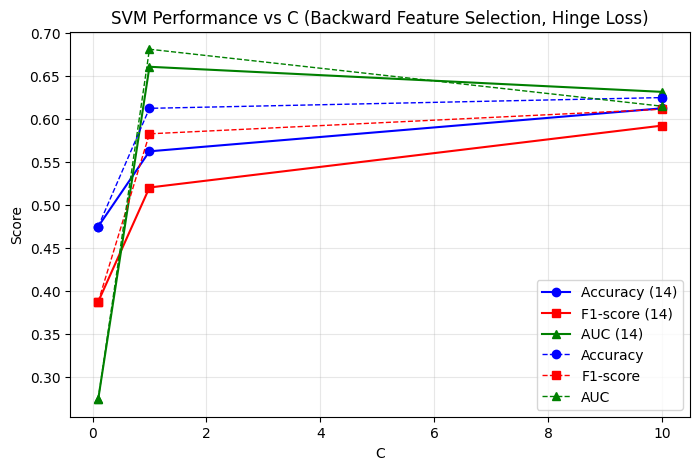

In [ ]:
y = features.Group
X = features.drop(['Group'],axis = 1)


C_values = [0.1, 1, 10]
numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True, random_state=42)


feature_names = list(X.columns)
X = X.values
Y = np.array(Y)

Y_svm = np.where(Y == 0, -1, 1)

results_feature = {}

# Loop over  C

for C in C_values:
    print(f"\n============================")
    print(f"Testing SVM with C = {C}")
    print(f"============================")

    acc_list = []
    f1_list = []
    auc_list = []

    for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
        print(f"\nFold {fold}/{10}")
        X_train, X_test = X[train_idx], X[test_idx]
        y_train, y_test = Y[train_idx], Y[test_idx]
        y_train_svm = Y_svm[train_idx]

        #Normalisation
        scaler = MinMaxScaler().fit(X_train)
        X_train = scaler.transform(X_train)
        X_test = scaler.transform(X_test)

        selected_features = feature_names.copy()

        feature_idx = [feature_names.index(f) for f in selected_features]
        model = SVC(C=C, kernel='linear', random_state=42)
        model.fit(X_train[:, feature_idx], y_train_svm)
        scores = model.decision_function(X_train[:, feature_idx])
        best_loss = np.mean(np.maximum(0, 1 - y_train_svm * scores))

        target_num_features = 14

        # Cross-Validation Loop

        while len(selected_features) > target_num_features:
            trial_losses = []
            # Run feature selection using training dat
            for feat in selected_features:
                trial_features = [f for f in selected_features if f != feat]
                trial_idx = [feature_names.index(f) for f in trial_features]

                model = SVC(C=C, kernel='linear', random_state=42)
                model.fit(X_train[:, trial_idx], y_train_svm)
                scores = model.decision_function(X_train[:, trial_idx])
                loss = np.mean(np.maximum(0, 1 - y_train_svm * scores))
                trial_losses.append((feat, loss))

            best_feat, feat_loss = min(trial_losses, key=lambda x: x[1])

            if feat_loss < best_loss:
                best_loss = feat_loss
                selected_features.remove(best_feat)
            else:
                selected_features.remove(best_feat)
        print("Number of feature selectionned :",len(selected_features))
        print(f"Features selected: {selected_features}")
        print()

        #  Train model using selected features and “train” data for this fold
        feature_idx = [feature_names.index(f) for f in selected_features]
        model = SVC(C=C, kernel='linear', random_state=42, probability=True)
        model.fit(X_train[:, feature_idx], y_train)

        # Evaluate model using “test” samples
        y_pred = model.predict(X_test[:, feature_idx])
        y_prob = model.predict_proba(X_test[:, feature_idx])[:, 1]

        acc = accuracy_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        auc = roc_auc_score(y_test, y_prob)

        acc_list.append(acc)
        f1_list.append(f1)
        auc_list.append(auc)

        print(f"Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")

    # calculate average performance metric
    results_feature[C] = {
        'mean_acc': np.mean(acc_list),
        'std_acc': np.std(acc_list),
        'mean_f1': np.mean(f1_list),
        'std_f1': np.std(f1_list),
        'mean_auc': np.mean(auc_list),
        'std_auc': np.std(auc_list)

    }

    print(f"\nC={C} Summary:")
    print(f"Mean Accuracy: {results_feature[C]['mean_acc']:.3f} ± {results_feature[C]['std_acc']:.3f}")
    print(f"Mean F1:       {results_feature[C]['mean_f1']:.3f} ± {results_feature[C]['std_f1']:.3f}")
    print(f"Mean AUC:      {results_feature[C]['mean_auc']:.3f} ± {results_feature[C]['std_auc']:.3f}")
    print("---------------------------")


print("\n========== Summary ==========")
print("C    MeanAcc   MeanF1   MeanAUC")
for C in C_values:
    r = results_feature[C]
    print(f"{C:<4} {r['mean_acc']:.3f} ± {r['std_acc']:.3f}  {r['mean_f1']:.3f} ± {r['std_f1']:.3f}    {r['mean_auc']:.3f} ± {r['std_auc']:.3f} ")

# Plot
plt.figure(figsize=(8,5))
plt.plot(C_values, [results_feature[C]['mean_acc'] for C in C_values], marker='o', label='Accuracy (14)',color='blue')
plt.plot(C_values, [results_feature[C]['mean_f1'] for C in C_values], marker='s', label='F1-score (14)',color='red')
plt.plot(C_values, [results_feature[C]['mean_auc'] for C in C_values], marker='^', label='AUC (14)',color='green')

plt.plot(C_values, [results[C]['mean_acc'] for C in C_values], marker='o', linestyle='--', linewidth=1, label='Accuracy',color='blue')
plt.plot(C_values, [results[C]['mean_f1'] for C in C_values], marker='s', linestyle='--', linewidth=1 ,label='F1-score',color='red')
plt.plot(C_values, [results[C]['mean_auc'] for C in C_values], marker='^', linestyle='--', linewidth=1, label='AUC',color='green')



plt.xlabel('C')
plt.ylabel('Score')
plt.title('SVM Performance vs C (Backward Feature Selection, Hinge Loss)')
plt.grid(alpha=0.3)
plt.legend()
plt.show()


When the feature selection was forcibly limited to 14 features, the SVM’s performance was generally lower than in previous experiments. Mean accuracy, F1, and AUC all decreased, showing that fixing the number of features reduces the model’s effectiveness. This actually confirms that the original wrapper feature selection is working well: by allowing the model to choose the most relevant features dynamically, it achieves better performance, while a forced selection of features leads to suboptimal results.

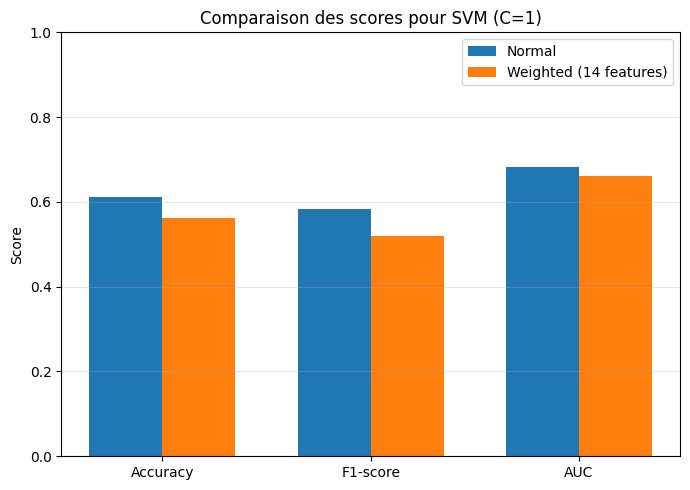

In [43]:
C_selected = 1
metrics = ['mean_acc', 'mean_f1', 'mean_auc']
metric_labels = ['Accuracy', 'F1-score', 'AUC']

# values for that C
normal = [results[C_selected][m] for m in metrics]
weighted = [results_feature[C_selected][m] for m in metrics]  # "weighted" = version with 14 features


x = np.arange(len(metrics))
width = 0.35

plt.figure(figsize=(7, 5))
plt.bar(x - width/2, normal, width, label='Normal')
plt.bar(x + width/2, weighted, width, label='Weighted (14 features)')

plt.xticks(x, metric_labels)
plt.ylabel('Score')
plt.ylim(0, 1)  # scores entre 0 et 1
plt.title(f'Comparaison des scores pour SVM (C={C_selected})')
plt.legend()
plt.grid(axis='y', alpha=0.3)
plt.tight_layout()
plt.show()

# Random forest 

In [44]:
y = features.Group.values
X = features.drop(['Group'], axis=1).values
feature_names = list(features.drop(['Group'], axis=1).columns)

outer_folds = 10
inner_folds = 5
kf_outer = KFold(n_splits=outer_folds, shuffle=True, random_state=42)
kf_inner = KFold(n_splits=inner_folds, shuffle=True, random_state=42)

# Lists to store results
acc_list = []
f1_list = []
auc_list = []
selected_features_all = []

# Cross validation loop
for fold, (train_idx, test_idx) in enumerate(kf_outer.split(X), 1):
    print(f"\nFold {fold}/{outer_folds}")
    
    # Assign train and test
    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = y[train_idx], y[test_idx]

    selected_features = feature_names.copy()
    best_score = 0
    improving = True

    # Run feature selection using training data
    while len(selected_features) > 1 and improving:
        fold_scores = []
        
        # Use inner cross validation to evaluate the feature selection 
        for inner_train_idx, inner_val_idx in kf_inner.split(X_train):
            X_in_train, X_in_val = X_train[inner_train_idx], X_train[inner_val_idx]
            y_in_train, y_in_val = y_train[inner_train_idx], y_train[inner_val_idx]
            
            model = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=42)
            model.fit(X_in_train[:, [feature_names.index(f) for f in selected_features]], y_in_train)
            
            y_pred = model.predict(X_in_val[:, [feature_names.index(f) for f in selected_features]])
            fold_scores.append(f1_score(y_in_val, y_pred))
        
        mean_score = np.mean(fold_scores)
        
        # If there is an improvement, we try to remove a feature
        if mean_score >= best_score:
            best_score = mean_score
            
            # Delete least important feature
            model = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=42)
            model.fit(X_train[:, [feature_names.index(f) for f in selected_features]], y_train)
            importances = model.feature_importances_
            worst_feat = selected_features[np.argmin(importances)]
            selected_features.remove(worst_feat)
        else:
            improving = False

    # Train model using selected features and "train" data for this fold
    selected_features_all.append(selected_features)
    X_train_sel = X_train[:, [feature_names.index(f) for f in selected_features]]
    X_test_sel = X_test[:, [feature_names.index(f) for f in selected_features]]

    final_model = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=42)
    final_model.fit(X_train_sel, y_train)
    
    # Evaluate model using "test" sample
    y_pred = final_model.predict(X_test_sel)
    y_prob = final_model.predict_proba(X_test_sel)[:, 1]

    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    acc_list.append(acc)
    f1_list.append(f1)
    auc_list.append(auc)

    print(f"  Number of features selected: {len(selected_features)}")
    print(f"  Features selected: {selected_features}")
    print(f"  Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")

# Calculate average performance metrics
print("\n---------------------------")
print(f"Mean Accuracy: {np.mean(acc_list):.3f} ± {np.std(acc_list):.3f}")
print(f"Mean F1-score: {np.mean(f1_list):.3f} ± {np.std(f1_list):.3f}")
print(f"Mean AUC     : {np.mean(auc_list):.3f} ± {np.std(auc_list):.3f}")
print("---------------------------")

# Feature frequency analysis
flat_feats = [f for sublist in selected_features_all for f in sublist]
counts = Counter(flat_feats)

print("\n========== Top Features Selected ==========")
for feat, c in counts.most_common(10):
    print(f"{feat}: {c}/{outer_folds} folds")


Fold 1/10
  Number of features selected: 14
  Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_01 (m/sec)']
  Accuracy: 0.875, F1: 0.889, AUC: 1.000

Fold 2/10
  Number of features selected: 11
  Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Speed_01 (m/sec)']
  Accuracy: 0.875, F1: 0.857, AUC: 0.875

Fold 3/10
  Number of features selected: 14
  Features selected: ['stride_mean', 'stride_cv', 'stride_sym', 'force_diff_mean', 'force_diff_cv_global', 'force_diff_sym', 'stance_swing_cv', 'stance_swing_sym', 'double_support_step_mean', 'double_support_step_cv', 'Age', 'Height (meters)', 'Weight (kg)', 'Speed_

In this analysis, we also applied nested cross-validation with feature selection using a Random Forest classifier. 

The dataset was split into 10 outer folds for evaluation and 5 inner folds for selecting the most informative features. Within each outer fold, features were iteratively removed based on their importance scores to maximize the F1 score on the inner validation set. After feature selection, the model was trained on the reduced set and evaluated on the outer test fold.

Across folds, performance metrics such as Accuracy, F1, and AUC showed moderate predictive ability. Interestingly, the selection process often retained 14 features out of the original set. 

Some features, like stride and speed-related measures, were consistently selected in all folds, highlighting their importance for classification. Overall, the model identifies key predictors but suggests that further refinement of feature selection could simplify the model without sacrificing performance.

In [45]:

y = features.Group
X = features.drop(['Group'], axis=1)

feature_names = list(X.columns)
X = X.values
Y = np.array(y)


numFolds = 10
kf = KFold(n_splits=numFolds, shuffle=True)


acc_list_wf = []
f1_list_wf = []
auc_list_wf = []

# Cross-validation loop

for fold, (train_idx, test_idx) in enumerate(kf.split(X), 1):
    print(f"\nFold {fold}/{numFolds}")

    X_train, X_test = X[train_idx], X[test_idx]
    y_train, y_test = Y[train_idx], Y[test_idx]

    # Training on all the features using required hyperparameters
    model = RandomForestClassifier(
        n_estimators=20,
        max_depth=10
    )
    model.fit(X_train, y_train)

    # Evaluation
    y_pred = model.predict(X_test)
    y_prob = model.predict_proba(X_test)[:, 1]

    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc = roc_auc_score(y_test, y_prob)

    acc_list_wf.append(acc)
    f1_list_wf.append(f1)
    auc_list_wf.append(auc)

    print(f"Accuracy: {acc:.3f}, F1: {f1:.3f}, AUC: {auc:.3f}")


# Calculate average performance metrics

results_rf = {
    'mean_acc': np.mean(acc_list_wf),
    'std_acc': np.std(acc_list_wf),
    'mean_f1': np.mean(f1_list_wf),
    'std_f1': np.std(f1_list_wf),
    'mean_auc': np.mean(auc_list_wf)
}

print("---------------------------")
print("Random Forest (every features)) Summary:")
print(f"Mean Accuracy: {results_rf['mean_acc']:.3f} ± {results_rf['std_acc']:.3f}")
print(f"Mean F1:       {results_rf['mean_f1']:.3f} ± {results_rf['std_f1']:.3f}")
print(f"Mean AUC     : {np.mean(auc_list):.3f} ± {np.std(auc_list):.3f}")
print("---------------------------")





Fold 1/10
Accuracy: 0.500, F1: 0.333, AUC: 0.344

Fold 2/10
Accuracy: 0.625, F1: 0.571, AUC: 0.833

Fold 3/10
Accuracy: 0.750, F1: 0.667, AUC: 0.917

Fold 4/10
Accuracy: 0.500, F1: 0.500, AUC: 1.000

Fold 5/10
Accuracy: 0.750, F1: 0.667, AUC: 0.917

Fold 6/10
Accuracy: 0.375, F1: 0.286, AUC: 0.367

Fold 7/10
Accuracy: 0.500, F1: 0.500, AUC: 0.688

Fold 8/10
Accuracy: 0.500, F1: 0.600, AUC: 0.567

Fold 9/10
Accuracy: 0.500, F1: 0.600, AUC: 0.531

Fold 10/10
Accuracy: 0.625, F1: 0.667, AUC: 0.800
---------------------------
Random Forest (every features)) Summary:
Mean Accuracy: 0.562 ± 0.115
Mean F1:       0.539 ± 0.129
Mean AUC     : 0.632 ± 0.251
---------------------------


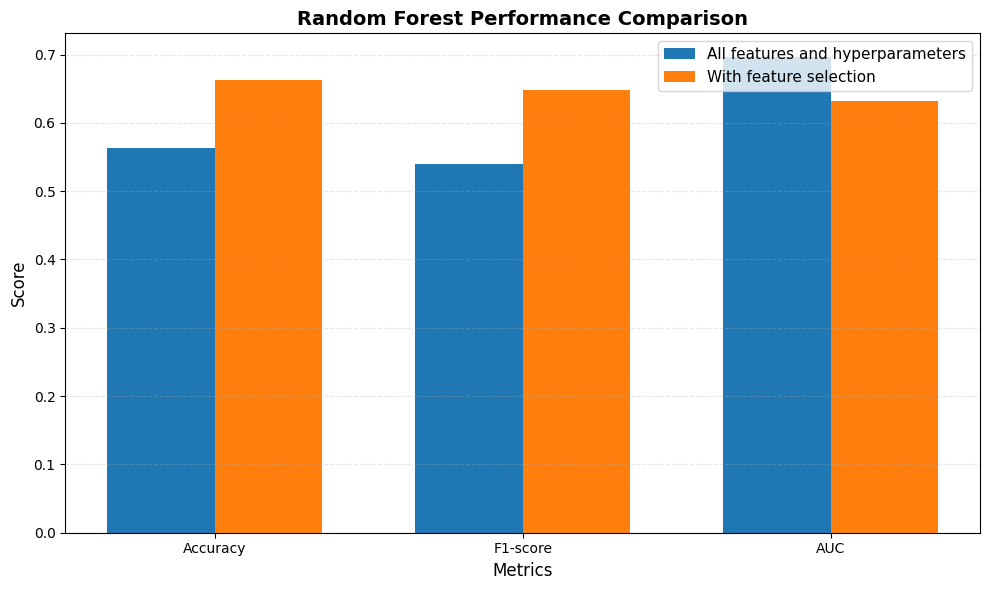

In [46]:
results_rf_fs = {
    'mean_acc': np.mean(acc_list),
    'std_acc': np.std(acc_list),
    'mean_f1': np.mean(f1_list),
    'std_f1': np.std(f1_list),
    'mean_auc': np.mean(auc_list),
    'std_auc': np.std(auc_list)
}

fig, ax = plt.subplots(figsize=(10, 6))

metrics = ['Accuracy', 'F1-score', 'AUC']
x = np.arange(len(metrics))
width = 0.35

bars1 = ax.bar(x - width/2, 
               [results_rf['mean_acc'], results_rf['mean_f1'], results_rf['mean_auc']],
               width, 
               label='All features and hyperparameters')

bars2 = ax.bar(x + width/2, 
               [results_rf_fs['mean_acc'], results_rf_fs['mean_f1'], results_rf_fs['mean_auc']],
               width, 
               label='With feature selection')

ax.set_xlabel('Metrics', fontsize=12)
ax.set_ylabel('Score', fontsize=12)
ax.set_title('Random Forest Performance Comparison', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(metrics)
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

When we removed the feature selection and used all features, the model's precision decreased significantly (Mean F1-score dropped to 0.539). This shows that the wrapper process, despite its instability, was successful at identifying the most predictive features and filtering out noise.

In summary, we faced a clear trade-off between the feature selection model, which achieved higher accuracy at the cost of high instability, and the all-features model, which was significantly more stable but also much less accurate.
